# Part 1: Automobile

Import and warehouse data

In [1]:
!pip install lucifer-ml

In [75]:
import pandas as pd 
import numpy as np 
import seaborn as sns
import matplotlib.pyplot as plt 
from collections import Counter
from sklearn.model_selection import train_test_split
import plotly.graph_objects as go
import plotly.express as px
from luciferml.supervised import classification as cls

In [76]:
Car = pd.read_json('Part1 - Car-Attributes.json')
print(Car.shape)
Car.head()

(398, 8)


,mpg,cyl,disp,hp,wt,acc,yr,origin
0,18.0,8,307.0,130,3504,12.0,70,1
1,15.0,8,350.0,165,3693,11.5,70,1
2,18.0,8,318.0,150,3436,11.0,70,1
3,16.0,8,304.0,150,3433,12.0,70,1
4,17.0,8,302.0,140,3449,10.5,70,1


In [77]:
Car1 = pd.read_csv('Part1 - Car name.csv')
print(Car1.shape)
Car1.head()

(398, 1)


,car_name
0,chevrolet chevelle malibu
1,buick skylark 320
2,plymouth satellite
3,amc rebel sst
4,ford torino


In [78]:
Automobile = pd.concat([Car,Car1],axis=1)

In [79]:
print(Automobile.shape)
Automobile.head()

(398, 9)


,mpg,cyl,disp,hp,wt,acc,yr,origin,car_name
0,18.0,8,307.0,130,3504,12.0,70,1,chevrolet chevelle malibu
1,15.0,8,350.0,165,3693,11.5,70,1,buick skylark 320
2,18.0,8,318.0,150,3436,11.0,70,1,plymouth satellite
3,16.0,8,304.0,150,3433,12.0,70,1,amc rebel sst
4,17.0,8,302.0,140,3449,10.5,70,1,ford torino


In [80]:
Automobile.to_csv('mpg.csv', index=False)
Automobile.to_excel('mpg.xlsx', index = False)
Automobile.to_json('mpg.json', orient = 'split', compression = 'infer', index = 'true')

In [81]:
Automobile.dtypes

mpg         float64
cyl           int64
disp        float64
hp           object
wt            int64
acc         float64
yr            int64
origin        int64
car_name     object
dtype: object

In [82]:
print(Automobile.isnull().sum())

mpg         0
cyl         0
disp        0
hp          0
wt          0
acc         0
yr          0
origin      0
car_name    0
dtype: int64


Data cleansing, Data analysis and visualisation

In [83]:
Automobile.describe().T.style.bar(
    subset=['mean'],
    color='Reds').background_gradient(
    subset=['std'], cmap='ocean').background_gradient(subset=['50%'], cmap='PuBu')

,count,mean,std,min,25%,50%,75%,max
mpg,398.000000,23.514573,7.815984,9.000000,17.500000,23.000000,29.000000,46.600000
cyl,398.000000,5.454774,1.701004,3.000000,4.000000,4.000000,8.000000,8.000000
disp,398.000000,193.425879,104.269838,68.000000,104.250000,148.500000,262.000000,455.000000
wt,398.000000,2970.424623,846.841774,1613.000000,2223.750000,2803.500000,3608.000000,5140.000000
acc,398.000000,15.568090,2.757689,8.000000,13.825000,15.500000,17.175000,24.800000
yr,398.000000,76.010050,3.697627,70.000000,73.000000,76.000000,79.000000,82.000000
origin,398.000000,1.572864,0.802055,1.000000,1.000000,1.000000,2.000000,3.000000


In [84]:
def boxhistplot(columns,data):
    fig = px.histogram(Automobile, x = Automobile[column], color = 'car_name')
    fig.show()
    fig2 = px.box(Automobile, x = Automobile[column], color = 'car_name')
    fig2.show()

In [85]:
col = ['mpg','cyl','disp','wt','acc','yr','origin','hp']
for column in col:
    boxhistplot(column, Automobile)

<AxesSubplot:>

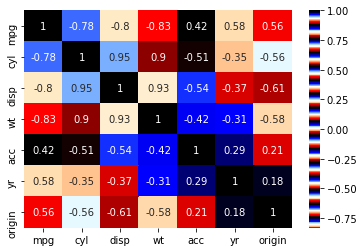

In [22]:
sns.heatmap(Automobile.corr(), annot=True, cmap="flag")

In [23]:
Automobile_num=Automobile.drop(['cyl','yr','origin','mpg','car_name'],axis=1)
Automobile_num.head()

,disp,hp,wt,acc
0,307.0,130,3504,12.0
1,350.0,165,3693,11.5
2,318.0,150,3436,11.0
3,304.0,150,3433,12.0
4,302.0,140,3449,10.5


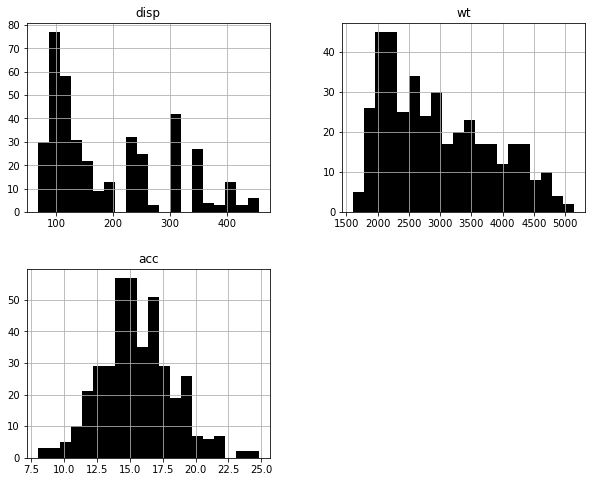

In [24]:
Automobile_num.hist(bins = 20, figsize = (10, 8), color = 'Black')
plt.show()

In [25]:
import numpy as np   
from sklearn.linear_model import LinearRegression
from scipy import stats 
from scipy.stats import zscore
from scipy.cluster.hierarchy import dendrogram, linkage
from scipy.cluster.hierarchy import fcluster
from sklearn.cluster import KMeans 
from sklearn.metrics import silhouette_samples, silhouette_score
import pandas as pd    
import matplotlib.pyplot as plt 
import seaborn as sns
%matplotlib inline 
sns.set(color_codes=True)
%matplotlib inline
import warnings
warnings.filterwarnings('ignore')
from sklearn.model_selection import train_test_split

In [26]:
Automobile_num.info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 398 entries, 0 to 397
Data columns (total 4 columns):
 #   Column  Non-Null Count  Dtype  
---  ------  --------------  -----  
 0   disp    398 non-null    float64
 1   hp      398 non-null    object 
 2   wt      398 non-null    int64  
 3   acc     398 non-null    float64
dtypes: float64(2), int64(1), object(1)
memory usage: 12.6+ KB


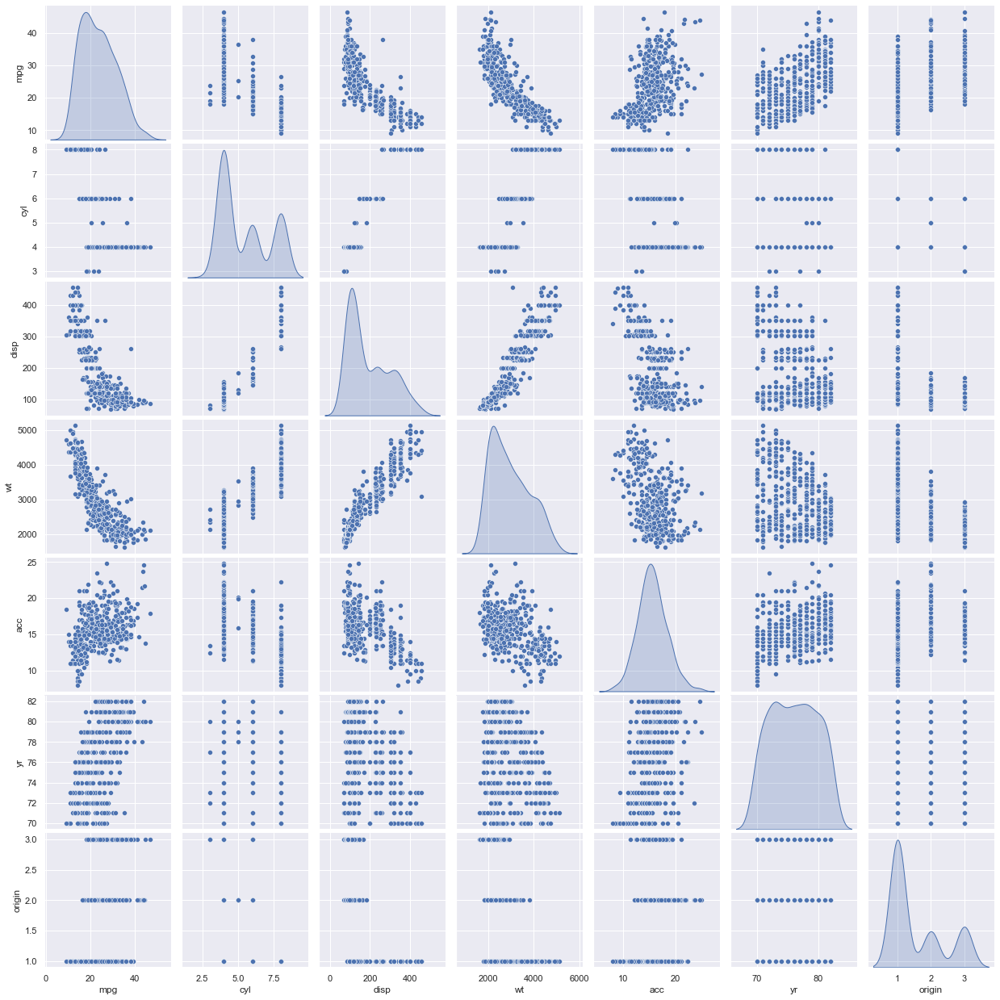

In [27]:
sns.pairplot(Automobile, diag_kind='kde')

Machine learning

K-Means

In [28]:
pip install h2o

In [29]:
import h2o
from h2o.estimators import H2OKMeansEstimator
h2o.init(strict_version_check=False, url="http://192.168.59.147:54321")

Checking whether there is an H2O instance running at http://192.168.59.147:54321 ..... not found.
Attempting to start a local H2O server...
; Java HotSpot(TM) 64-Bit Server VM (build 25.311-b11, mixed mode)
  Starting server from C:\Users\Admin\anaconda3\Lib\site-packages\h2o\backend\bin\h2o.jar
  Ice root: C:\Users\Admin\AppData\Local\Temp\tmps5cutt0a
  JVM stdout: C:\Users\Admin\AppData\Local\Temp\tmps5cutt0a\h2o_Admin_started_from_python.out
  JVM stderr: C:\Users\Admin\AppData\Local\Temp\tmps5cutt0a\h2o_Admin_started_from_python.err
  Server is running at http://127.0.0.1:54323
Connecting to H2O server at http://127.0.0.1:54323 ... successful.


H2O_cluster_uptime:,06 secs
H2O_cluster_timezone:,Asia/Kolkata
H2O_data_parsing_timezone:,UTC
H2O_cluster_version:,3.34.0.3
H2O_cluster_version_age:,1 month and 9 days
H2O_cluster_name:,H2O_from_python_Admin_bjvca0
H2O_cluster_total_nodes:,1
H2O_cluster_free_memory:,1.689 Gb
H2O_cluster_total_cores:,8
H2O_cluster_allowed_cores:,8
H2O_cluster_status:,"locked, healthy"


In [30]:
Automobile_Num = Automobile.iloc[:,0:7] 
Automobile_Num.head()
Automobile_Num.dtypes
Automobile_num2 = Automobile_Num.drop(['hp'],axis=1)
Automobile_Num_z1 = Automobile_num2.apply(zscore)
Automobile_Num_z1.head()

,mpg,cyl,disp,wt,acc,yr
0,-0.706439,1.498191,1.090604,0.630870,-1.295498,-1.627426
1,-1.090751,1.498191,1.503514,0.854333,-1.477038,-1.627426
2,-0.706439,1.498191,1.196232,0.550470,-1.658577,-1.627426
3,-0.962647,1.498191,1.061796,0.546923,-1.295498,-1.627426
4,-0.834543,1.498191,1.042591,0.565841,-1.840117,-1.627426


0.4395212407688038

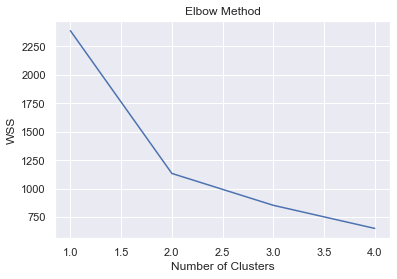

In [31]:
wss =[] 
for i in range(1,5):
    KM = KMeans(n_clusters=i)
    KM.fit(Automobile_Num_z1)
    wss.append(KM.inertia_)
wss

plt.plot(range(1,5), wss);
plt.title('Elbow Method');
plt.xlabel("Number of Clusters")
plt.ylabel("WSS");

k_means = KMeans(n_clusters = 2)
k_means.fit(Automobile_Num_z1)
labels = k_means.labels_

silhouette_score(Automobile_Num_z1,labels)

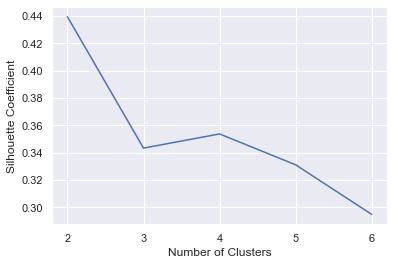

In [32]:
kmeans_kwargs = {
   "init": "random",
   "n_init": 10,
   "max_iter": 300,
   "random_state": 42,
}


silhouette_coefficients = []

for k in range(2, 7):
    kmeans = KMeans(n_clusters=k, **kmeans_kwargs)
    kmeans.fit(Automobile_Num_z1)
    score = silhouette_score(Automobile_Num_z1,kmeans.labels_)
    silhouette_coefficients.append(score)
    
plt.plot(range(2, 7), silhouette_coefficients)
plt.xticks(range(2, 7))
plt.xlabel("Number of Clusters")
plt.ylabel("Silhouette Coefficient")
plt.show()
    

In [33]:
from timeit import default_timer as timer
from datetime import timedelta
import time
start = timer()
end = timer()
print("Time:", timedelta(seconds=end-start))

Time: 0:00:00.000049


In [34]:
dataset_h2o = h2o.H2OFrame(Automobile_num2)
h2o_km = H2OKMeansEstimator(k=2, init="furthest", standardize=True)
start = timer()
h2o_km.train(training_frame=dataset_h2o)
end = timer()
user_points = h2o.H2OFrame(h2o_km.centers())
h2o_km.show()
time_km = timedelta(seconds=end-start)
print("Time:", time_km)

Parse progress: |████████████████████████████████████████████████████████████████| (done) 100%
kmeans Model Build progress: |███████████████████████████████████████████████████| (done) 100%
Parse progress: |████████████████████████████████████████████████████████████████| (done) 100%
Model Details
H2OKMeansEstimator :  K-means
Model Key:  KMeans_model_python_1637083921092_1


Model Summary: 


,,number_of_rows,number_of_clusters,number_of_categorical_columns,number_of_iterations,within_cluster_sum_of_squares,total_sum_of_squares,between_cluster_sum_of_squares
0,,398.0,2.0,0.0,4.0,1130.875093,2382.0,1251.124907




ModelMetricsClustering: kmeans
** Reported on train data. **

MSE: NaN
RMSE: NaN
Total Within Cluster Sum of Square Error: 1130.8750923291825
Total Sum of Square Error to Grand Mean: 2382.000012600604
Between Cluster Sum of Square Error: 1251.1249202714214

Centroid Statistics: 


,,centroid,size,within_cluster_sum_of_squares
0,,1.0,231.0,632.391393
1,,2.0,167.0,498.483699



Scoring History: 


,,timestamp,duration,iterations,number_of_reassigned_observations,within_cluster_sum_of_squares
0,,2021-11-16 23:02:21,0.134 sec,0.0,NaN,NaN
1,,2021-11-16 23:02:22,0.400 sec,1.0,398.0,2058.747250
2,,2021-11-16 23:02:22,0.439 sec,2.0,23.0,1140.428174
3,,2021-11-16 23:02:22,0.447 sec,3.0,2.0,1130.895393
4,,2021-11-16 23:02:22,0.454 sec,4.0,0.0,1130.875093


Time: 0:00:01.034527


In [35]:
h2o_km_co = H2OKMeansEstimator(k=2, user_points=user_points, cluster_size_constraints=[200, 150], standardize=True)
start = timer()
h2o_km_co.train(training_frame=dataset_h2o)
end = timer()
h2o_km_co.show()
time_km_co = timedelta(seconds=end-start)
print("Time:", time_km_co)

kmeans Model Build progress: |███████████████████████████████████████████████████| (done) 100%
Model Details
H2OKMeansEstimator :  K-means
Model Key:  KMeans_model_python_1637083921092_2


Model Summary: 


,,number_of_rows,number_of_clusters,number_of_categorical_columns,number_of_iterations,within_cluster_sum_of_squares,total_sum_of_squares,between_cluster_sum_of_squares
0,,398.0,2.0,0.0,2.0,1130.875093,2382.0,1251.124907




ModelMetricsClustering: kmeans
** Reported on train data. **

MSE: NaN
RMSE: NaN
Total Within Cluster Sum of Square Error: 1130.8750927223805
Total Sum of Square Error to Grand Mean: 2382.000000000007
Between Cluster Sum of Square Error: 1251.1249072776263

Centroid Statistics: 


,,centroid,size,within_cluster_sum_of_squares
0,,1.0,231.0,632.391397
1,,2.0,167.0,498.483695



Scoring History: 


,,timestamp,duration,iterations,number_of_reassigned_observations,within_cluster_sum_of_squares
0,,2021-11-16 23:02:23,0.000 sec,0.0,NaN,NaN
1,,2021-11-16 23:02:24,1.615 sec,1.0,398.0,1130.875093
2,,2021-11-16 23:02:25,2.359 sec,2.0,0.0,1130.875093


Time: 0:00:02.540205


In [36]:
import pandas as pd
dataset = pd.read_csv('mpg.csv')
print(dataset.shape)
dataset.head()

(398, 9)


,mpg,cyl,disp,hp,wt,acc,yr,origin,car_name
0,18.0,8,307.0,130,3504,12.0,70,1,chevrolet chevelle malibu
1,15.0,8,350.0,165,3693,11.5,70,1,buick skylark 320
2,18.0,8,318.0,150,3436,11.0,70,1,plymouth satellite
3,16.0,8,304.0,150,3433,12.0,70,1,amc rebel sst
4,17.0,8,302.0,140,3449,10.5,70,1,ford torino


In [37]:
dataset_h2o = h2o.H2OFrame(dataset)
h2o_km = H2OKMeansEstimator(k=2, init="furthest", standardize=True)
start = timer()
h2o_km.train(training_frame=dataset_h2o)
end = timer()
user_points = h2o.H2OFrame(h2o_km.centers())
h2o_km.show()
time_km = timedelta(seconds=end-start)
print("Time:", time_km)

Parse progress: |████████████████████████████████████████████████████████████████| (done) 100%
kmeans Model Build progress: |███████████████████████████████████████████████████| (done) 100%
Parse progress: |████████████████████████████████████████████████████████████████| (done) 100%
Model Details
H2OKMeansEstimator :  K-means
Model Key:  KMeans_model_python_1637083921092_3


Model Summary: 


,,number_of_rows,number_of_clusters,number_of_categorical_columns,number_of_iterations,within_cluster_sum_of_squares,total_sum_of_squares,between_cluster_sum_of_squares
0,,398.0,2.0,1.0,9.0,1985.139986,3562.0,1576.860014




ModelMetricsClustering: kmeans
** Reported on train data. **

MSE: NaN
RMSE: NaN
Total Within Cluster Sum of Square Error: 1985.139993914968
Total Sum of Square Error to Grand Mean: 3562.00002311023
Between Cluster Sum of Square Error: 1576.8600291952619

Centroid Statistics: 


,,centroid,size,within_cluster_sum_of_squares
0,,1.0,274.0,1496.311194
1,,2.0,124.0,488.828800



Scoring History: 


,,timestamp,duration,iterations,number_of_reassigned_observations,within_cluster_sum_of_squares
0,,2021-11-16 23:02:26,0.004 sec,0.0,NaN,NaN
1,,2021-11-16 23:02:26,0.033 sec,1.0,398.0,3648.147094
2,,2021-11-16 23:02:26,0.037 sec,2.0,45.0,2172.341607
3,,2021-11-16 23:02:26,0.041 sec,3.0,8.0,2008.852715
4,,2021-11-16 23:02:26,0.044 sec,4.0,6.0,2001.856427
5,,2021-11-16 23:02:26,0.047 sec,5.0,6.0,1995.861084
6,,2021-11-16 23:02:26,0.050 sec,6.0,5.0,1988.416527
7,,2021-11-16 23:02:26,0.053 sec,7.0,2.0,1985.647628
8,,2021-11-16 23:02:26,0.055 sec,8.0,1.0,1985.208974
9,,2021-11-16 23:02:26,0.057 sec,9.0,0.0,1985.139986


Time: 0:00:00.269699


In [38]:
dataset.columns = ["mpg","cyl","disp","hp","wt","acc","yr","origin","car_name"]
dataset.loc[dataset["car_name"] == "noise", "car_name"] = 9
dataset["car_name"] = dataset["car_name"].astype("category")
dataset

,mpg,cyl,disp,hp,wt,acc,yr,origin,car_name
0,18.0,8,307.0,130,3504,12.0,70,1,chevrolet chevelle malibu
1,15.0,8,350.0,165,3693,11.5,70,1,buick skylark 320
2,18.0,8,318.0,150,3436,11.0,70,1,plymouth satellite
3,16.0,8,304.0,150,3433,12.0,70,1,amc rebel sst
4,17.0,8,302.0,140,3449,10.5,70,1,ford torino
...,...,...,...,...,...,...,...,...,...
393,27.0,4,140.0,86,2790,15.6,82,1,ford mustang gl
394,44.0,4,97.0,52,2130,24.6,82,2,vw pickup
395,32.0,4,135.0,84,2295,11.6,82,1,dodge rampage
396,28.0,4,120.0,79,2625,18.6,82,1,ford ranger


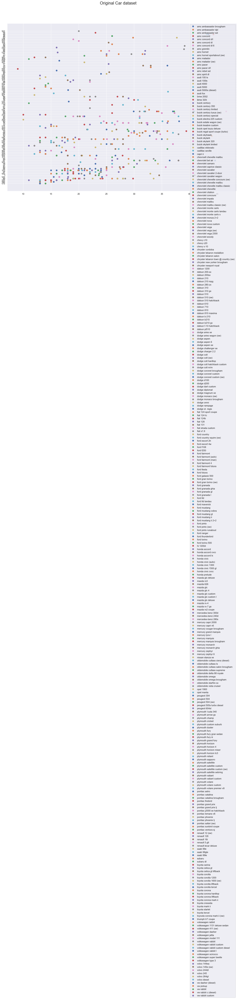

In [39]:
import matplotlib.pyplot as plt
groups = dataset.groupby('car_name')
fig, ax = plt.subplots(1,1,figsize=(20,15))

for name, group in groups:
    ax.plot(group.mpg, group.hp, marker='o', linestyle='', ms=7, label=name)
fig.suptitle("Original Car dataset", fontsize=20)    
ax.legend(numpoints=1)

In [40]:
data_h2o_dataset = h2o.H2OFrame(dataset)
h2o_km_dataset = H2OKMeansEstimator(k=2, init="furthest", standardize=True)
start = timer()
h2o_km_dataset.train(x=["mpg", "hp"], training_frame=data_h2o_dataset)
end = timer()
user_points = h2o.H2OFrame(h2o_km_dataset.centers())
h2o_km_dataset.show()
print("Time:", timedelta(seconds=end-start))

Parse progress: |████████████████████████████████████████████████████████████████| (done) 100%
kmeans Model Build progress: |███████████████████████████████████████████████████| (done) 100%
Parse progress: |████████████████████████████████████████████████████████████████| (done) 100%
Model Details
H2OKMeansEstimator :  K-means
Model Key:  KMeans_model_python_1637083921092_4


Model Summary: 


,,number_of_rows,number_of_clusters,number_of_categorical_columns,number_of_iterations,within_cluster_sum_of_squares,total_sum_of_squares,between_cluster_sum_of_squares
0,,398.0,2.0,0.0,9.0,325.848475,788.0,462.151525




ModelMetricsClustering: kmeans
** Reported on train data. **

MSE: NaN
RMSE: NaN
Total Within Cluster Sum of Square Error: 325.8484792231544
Total Sum of Square Error to Grand Mean: 788.0000045834372
Between Cluster Sum of Square Error: 462.1515253602828

Centroid Statistics: 


,,centroid,size,within_cluster_sum_of_squares
0,,1.0,233.0,166.269692
1,,2.0,165.0,159.578787



Scoring History: 


,,timestamp,duration,iterations,number_of_reassigned_observations,within_cluster_sum_of_squares
0,,2021-11-16 23:02:58,0.029 sec,0.0,NaN,NaN
1,,2021-11-16 23:02:58,0.055 sec,1.0,398.0,1735.062601
2,,2021-11-16 23:02:58,0.058 sec,2.0,5.0,329.534171
3,,2021-11-16 23:02:58,0.061 sec,3.0,7.0,328.849956
4,,2021-11-16 23:02:58,0.066 sec,4.0,6.0,327.749765
5,,2021-11-16 23:02:58,0.070 sec,5.0,4.0,326.801268
6,,2021-11-16 23:02:58,0.073 sec,6.0,4.0,326.433332
7,,2021-11-16 23:02:58,0.076 sec,7.0,3.0,326.074668
8,,2021-11-16 23:02:58,0.080 sec,8.0,1.0,325.865553
9,,2021-11-16 23:02:58,0.082 sec,9.0,0.0,325.848475


Time: 0:00:00.324790


In [41]:
h2o_km_co_dataset = H2OKMeansEstimator(k=2, user_points=user_points, standardize=True)
start = timer()
h2o_km_co_dataset.train(x=["mpg","hp"], training_frame=data_h2o_dataset)
end = timer()
h2o_km_co_dataset.show()
time_h2o_km_co_dataset = timedelta(seconds=end-start)
print("Time:", time_h2o_km_co_dataset)

kmeans Model Build progress: |███████████████████████████████████████████████████| (done) 100%
Model Details
H2OKMeansEstimator :  K-means
Model Key:  KMeans_model_python_1637083921092_5


Model Summary: 


,,number_of_rows,number_of_clusters,number_of_categorical_columns,number_of_iterations,within_cluster_sum_of_squares,total_sum_of_squares,between_cluster_sum_of_squares
0,,398.0,2.0,0.0,2.0,325.848475,788.0,462.151525




ModelMetricsClustering: kmeans
** Reported on train data. **

MSE: NaN
RMSE: NaN
Total Within Cluster Sum of Square Error: 325.8484792231544
Total Sum of Square Error to Grand Mean: 788.0000045834372
Between Cluster Sum of Square Error: 462.1515253602828

Centroid Statistics: 


,,centroid,size,within_cluster_sum_of_squares
0,,1.0,233.0,166.269692
1,,2.0,165.0,159.578787



Scoring History: 


,,timestamp,duration,iterations,number_of_reassigned_observations,within_cluster_sum_of_squares
0,,2021-11-16 23:02:58,0.004 sec,0.0,NaN,NaN
1,,2021-11-16 23:02:58,0.008 sec,1.0,398.0,325.848475
2,,2021-11-16 23:02:58,0.010 sec,2.0,0.0,325.848475


Time: 0:00:00.285729


In [42]:
from h2o.estimators.aggregator import H2OAggregatorEstimator

params = { "target_num_exemplars": 350,
    "rel_tol_num_exemplars": 0.5,
    "categorical_encoding": "eigen"}

agg = H2OAggregatorEstimator(**params)

start = timer()
agg.train(x=["mpg","hp","car_name"], training_frame=data_h2o_dataset)
data_agg_12_dataset = agg.aggregated_frame
h2o_km_co_agg_12_dataset = H2OKMeansEstimator(k=2, user_points=user_points, standardize=True)

h2o_km_co_agg_12_dataset.train(x=["mpg","hp"],training_frame=data_agg_12_dataset)
end = timer()
h2o_km_co_agg_12_dataset.show()
time_h2o_km_co_agg_12_dataset = timedelta(seconds=end-start)
print("Time:", time_h2o_km_co_agg_12_dataset)

aggregator Model Build progress: |███████████████████████████████████████████████| (done) 100%
kmeans Model Build progress: |███████████████████████████████████████████████████| (done) 100%
Model Details
H2OKMeansEstimator :  K-means
Model Key:  KMeans_model_python_1637083921092_7


Model Summary: 


,,number_of_rows,number_of_clusters,number_of_categorical_columns,number_of_iterations,within_cluster_sum_of_squares,total_sum_of_squares,between_cluster_sum_of_squares
0,,246.0,2.0,0.0,2.0,195.502341,487.0,291.497659




ModelMetricsClustering: kmeans
** Reported on train data. **

MSE: NaN
RMSE: NaN
Total Within Cluster Sum of Square Error: 195.50234245877655
Total Sum of Square Error to Grand Mean: 487.0000009613941
Between Cluster Sum of Square Error: 291.4976585026176

Centroid Statistics: 


,,centroid,size,within_cluster_sum_of_squares
0,,1.0,143.0,98.890552
1,,2.0,103.0,96.611790



Scoring History: 


,,timestamp,duration,iterations,number_of_reassigned_observations,within_cluster_sum_of_squares
0,,2021-11-16 23:03:00,0.009 sec,0.0,NaN,NaN
1,,2021-11-16 23:03:00,0.018 sec,1.0,246.0,197.493165
2,,2021-11-16 23:03:00,0.025 sec,2.0,0.0,195.502341


Time: 0:00:01.347042


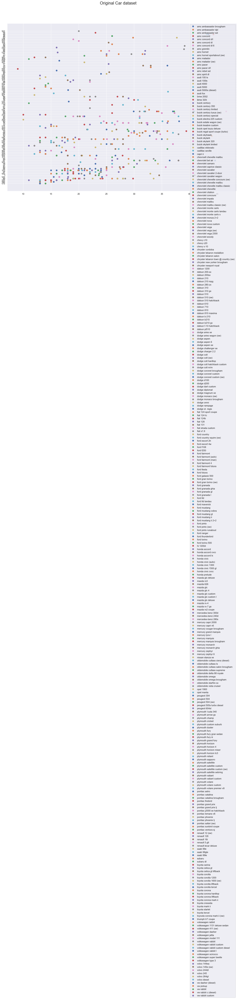

In [43]:
groups = dataset.groupby('car_name')
fig, ax = plt.subplots(1,1,figsize=(20,15))


for name, group in groups:
    ax.plot(group.mpg, group.hp, marker='o', linestyle='', ms=7, label=name)

fig.suptitle("Original Car dataset", fontsize=20)
ax.legend(numpoints=1)

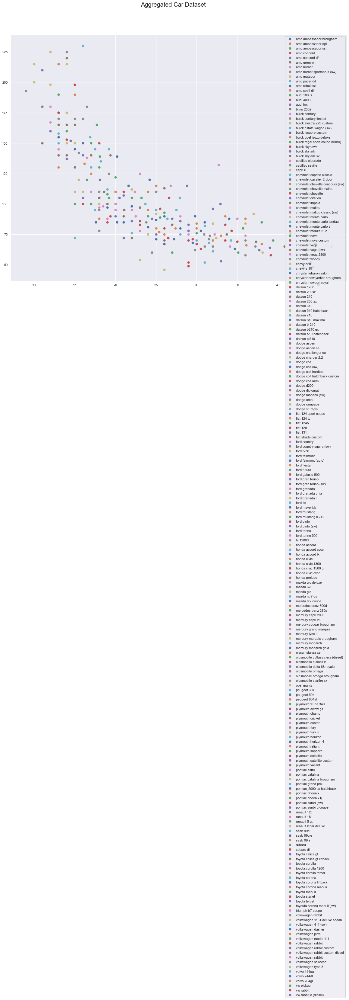

In [44]:
data_agg_df_12_dataset = data_agg_12_dataset.as_data_frame()
data_agg_df_12_dataset["car_name"] = data_agg_df_12_dataset["car_name"].astype("category")

groups = data_agg_df_12_dataset.groupby("car_name")
fig, ax = plt.subplots(1,1,figsize=(20,15))
for name, group in groups:
    ax.plot(group.mpg, group.hp, marker='o', linestyle='', ms=7, label=name)

fig.suptitle("Aggregated Car Dataset", fontsize=20)  
ax.legend(numpoints=1)

In [45]:
data_agg_df_12_dataset.head()

,mpg,cyl,disp,hp,wt,acc,yr,origin,car_name,counts
0,18.0,8,307.0,130.0,3504,12.0,70,1,chevrolet chevelle malibu,2
1,15.0,8,350.0,165.0,3693,11.5,70,1,buick skylark 320,1
2,18.0,8,318.0,150.0,3436,11.0,70,1,plymouth satellite,2
3,16.0,8,304.0,150.0,3433,12.0,70,1,amc rebel sst,4
4,17.0,8,302.0,140.0,3449,10.5,70,1,ford torino,3


In [46]:
data_agg_df_12_dataset.to_csv('kmeans.csv', index=False)

In [47]:
kmeans_data = pd.read_csv('kmeans.csv')
kmeans_data.head()

,mpg,cyl,disp,hp,wt,acc,yr,origin,car_name,counts
0,18.0,8,307.0,130.0,3504,12.0,70,1,chevrolet chevelle malibu,2
1,15.0,8,350.0,165.0,3693,11.5,70,1,buick skylark 320,1
2,18.0,8,318.0,150.0,3436,11.0,70,1,plymouth satellite,2
3,16.0,8,304.0,150.0,3433,12.0,70,1,amc rebel sst,4
4,17.0,8,302.0,140.0,3449,10.5,70,1,ford torino,3


kmeans prediction progress: |████████████████████████████████████████████████████| (done) 100%


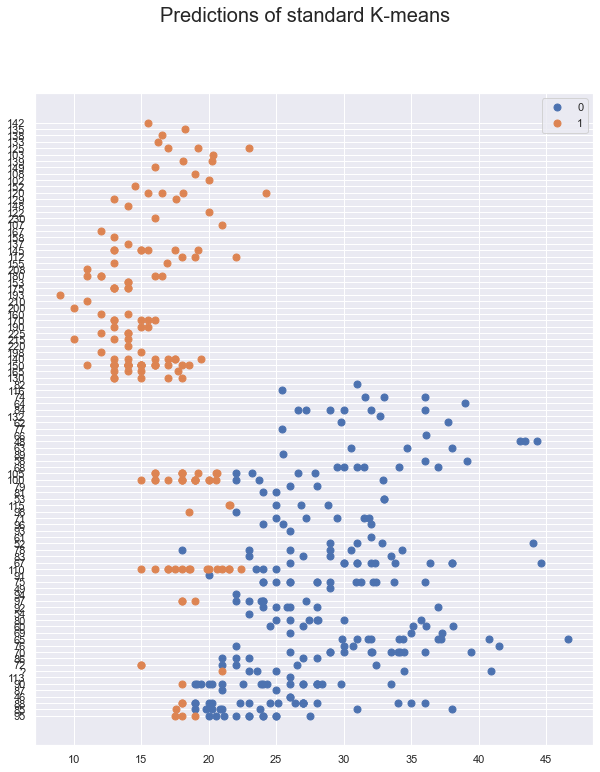

In [48]:
dataset["km_pred"] = h2o_km_dataset.predict(data_h2o_dataset).as_data_frame()['predict'].astype("category")

groups = dataset.groupby('km_pred')
fig, ax = plt.subplots(1,1,figsize=(10,12))


for name, group in groups:
    ax.plot(group.mpg, group.hp, marker='o', linestyle='', ms=7, label=name)

fig.suptitle("Predictions of standard K-means", fontsize=20)  
ax.legend(numpoints=1)

Hierarchical clustering

In [49]:
import warnings
warnings.filterwarnings('ignore')

from sklearn import preprocessing 
import scipy.cluster.hierarchy as sch
from sklearn.cluster import AgglomerativeClustering 

In [50]:
Auto = Automobile.iloc[:,0:7] 
Auto.head()

,mpg,cyl,disp,hp,wt,acc,yr
0,18.0,8,307.0,130,3504,12.0,70
1,15.0,8,350.0,165,3693,11.5,70
2,18.0,8,318.0,150,3436,11.0,70
3,16.0,8,304.0,150,3433,12.0,70
4,17.0,8,302.0,140,3449,10.5,70


In [51]:
hpIsDigit = pd.DataFrame(Auto.hp.str.isdigit()) 
Auto[hpIsDigit['hp'] == False] 

,mpg,cyl,disp,hp,wt,acc,yr
32,25.0,4,98.0,?,2046,19.0,71
126,21.0,6,200.0,?,2875,17.0,74
330,40.9,4,85.0,?,1835,17.3,80
336,23.6,4,140.0,?,2905,14.3,80
354,34.5,4,100.0,?,2320,15.8,81
374,23.0,4,151.0,?,3035,20.5,82


In [52]:
Auto = Auto.replace('?', np.nan)
Auto[hpIsDigit['hp'] == False] 

,mpg,cyl,disp,hp,wt,acc,yr
32,25.0,4,98.0,NaN,2046,19.0,71
126,21.0,6,200.0,NaN,2875,17.0,74
330,40.9,4,85.0,NaN,1835,17.3,80
336,23.6,4,140.0,NaN,2905,14.3,80
354,34.5,4,100.0,NaN,2320,15.8,81
374,23.0,4,151.0,NaN,3035,20.5,82


In [53]:
Auto.median()

mpg       23.0
cyl        4.0
disp     148.5
hp        93.5
wt      2803.5
acc       15.5
yr        76.0
dtype: float64

In [54]:
Auto['hp'].fillna((Auto['hp'].median()), inplace=True)

In [55]:
Auto.isnull().sum()

mpg     0
cyl     0
disp    0
hp      0
wt      0
acc     0
yr      0
dtype: int64

In [56]:
Auto_z = Auto.apply(zscore)
Auto_z.head()

,mpg,cyl,disp,hp,wt,acc,yr
0,-0.706439,1.498191,1.090604,0.673118,0.630870,-1.295498,-1.627426
1,-1.090751,1.498191,1.503514,1.589958,0.854333,-1.477038,-1.627426
2,-0.706439,1.498191,1.196232,1.197027,0.550470,-1.658577,-1.627426
3,-0.962647,1.498191,1.061796,1.197027,0.546923,-1.295498,-1.627426
4,-0.834543,1.498191,1.042591,0.935072,0.565841,-1.840117,-1.627426


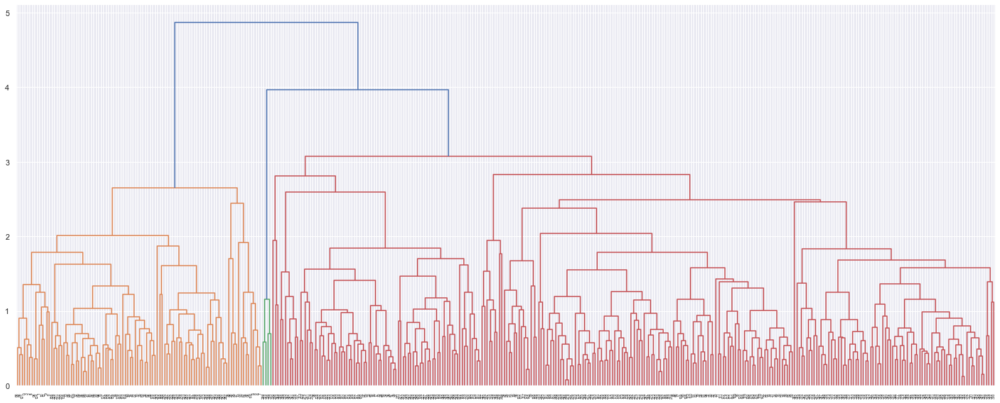

In [57]:
link_method = linkage(Auto_z.iloc[:,0:7], method = 'average')
plt.figure(figsize=(25, 10))
dendrogram(link_method)
plt.show()

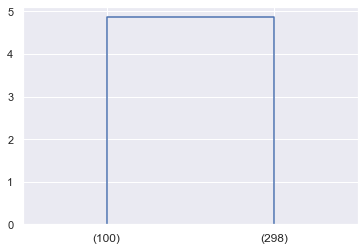

In [58]:
dendrogram(
    link_method,
    truncate_mode='lastp',  
    p=2,  
)
plt.show()

In [59]:
clusters = fcluster(link_method, 2, criterion='maxclust')
clusters

array([1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 2, 2, 2, 2, 2, 2, 2, 2,
       2, 2, 2, 1, 1, 1, 1, 2, 2, 2, 2, 2, 2, 2, 2, 2, 1, 1, 1, 1, 1, 1,
       1, 2, 2, 2, 2, 2, 2, 2, 2, 2, 2, 2, 2, 2, 2, 2, 2, 2, 1, 1, 1, 1,
       1, 1, 1, 1, 1, 2, 1, 1, 1, 1, 2, 2, 2, 2, 2, 2, 2, 2, 2, 1, 1, 1,
       1, 1, 1, 1, 1, 1, 1, 1, 1, 2, 2, 2, 2, 2, 2, 1, 1, 1, 1, 2, 2, 2,
       2, 2, 2, 2, 2, 1, 1, 2, 2, 2, 2, 1, 2, 2, 1, 2, 2, 2, 2, 2, 2, 2,
       2, 2, 2, 2, 1, 1, 1, 1, 1, 2, 2, 2, 2, 2, 2, 2, 2, 2, 2, 2, 2, 2,
       2, 2, 1, 1, 1, 1, 2, 2, 2, 2, 2, 1, 1, 2, 2, 2, 2, 2, 2, 2, 2, 2,
       2, 2, 2, 2, 2, 2, 2, 2, 2, 2, 2, 1, 1, 1, 1, 2, 2, 2, 2, 2, 2, 2,
       2, 2, 2, 2, 2, 2, 2, 2, 2, 2, 1, 2, 2, 2, 1, 1, 1, 1, 2, 2, 2, 2,
       2, 1, 2, 1, 1, 2, 2, 2, 2, 1, 1, 1, 1, 2, 2, 2, 2, 2, 2, 2, 2, 2,
       2, 2, 2, 2, 2, 2, 2, 1, 1, 1, 2, 2, 2, 2, 2, 2, 2, 2, 2, 2, 1, 1,
       1, 1, 2, 2, 2, 2, 2, 2, 2, 2, 2, 2, 2, 2, 2, 2, 2, 2, 2, 2, 2, 1,
       1, 1, 1, 1, 1, 1, 1, 2, 2, 2, 2, 2, 2, 2, 2,

In [60]:
Auto_z['clusters_H'] = clusters
Auto_z.head()

,mpg,cyl,disp,hp,wt,acc,yr,clusters_H
0,-0.706439,1.498191,1.090604,0.673118,0.630870,-1.295498,-1.627426,1
1,-1.090751,1.498191,1.503514,1.589958,0.854333,-1.477038,-1.627426,1
2,-0.706439,1.498191,1.196232,1.197027,0.550470,-1.658577,-1.627426,1
3,-0.962647,1.498191,1.061796,1.197027,0.546923,-1.295498,-1.627426,1
4,-0.834543,1.498191,1.042591,0.935072,0.565841,-1.840117,-1.627426,1


In [61]:
Auto_z.clusters_H.value_counts().sort_index()

1    100
2    298
Name: clusters_H, dtype: int64

In [62]:
Auto['clusters_H']=clusters
Auto['clusters_H']=clusters
Auto.head()

,mpg,cyl,disp,hp,wt,acc,yr,clusters_H
0,18.0,8,307.0,130.0,3504,12.0,70,1
1,15.0,8,350.0,165.0,3693,11.5,70,1
2,18.0,8,318.0,150.0,3436,11.0,70,1
3,16.0,8,304.0,150.0,3433,12.0,70,1
4,17.0,8,302.0,140.0,3449,10.5,70,1


In [63]:
Hclus=Auto
Hclus.head()

,mpg,cyl,disp,hp,wt,acc,yr,clusters_H
0,18.0,8,307.0,130.0,3504,12.0,70,1
1,15.0,8,350.0,165.0,3693,11.5,70,1
2,18.0,8,318.0,150.0,3436,11.0,70,1
3,16.0,8,304.0,150.0,3433,12.0,70,1
4,17.0,8,302.0,140.0,3449,10.5,70,1


In [64]:
aggdata=Auto.iloc[:,0:8].groupby('clusters_H').mean()
aggdata['Freq']=Auto.clusters_H.value_counts().sort_index()
aggdata

,mpg,cyl,disp,hp,wt,acc,yr,Freq
clusters_H,,,,,,,,
1,14.684000,7.980000,345.470000,160.400000,4121.560000,12.702000,73.740000,100
2,26.477852,4.607383,142.404362,85.479866,2584.137584,16.529866,76.771812,298


In [65]:
aggdata.head()

,mpg,cyl,disp,hp,wt,acc,yr,Freq
clusters_H,,,,,,,,
1,14.684000,7.980000,345.470000,160.400000,4121.560000,12.702000,73.740000,100
2,26.477852,4.607383,142.404362,85.479866,2584.137584,16.529866,76.771812,298


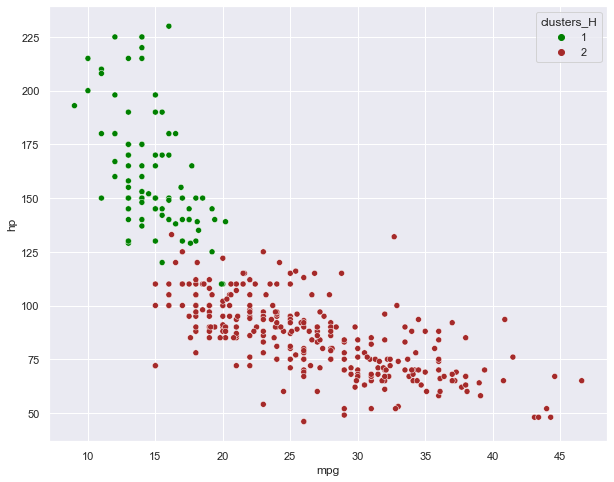

In [66]:
plt.figure(figsize=(10, 8))
sns.scatterplot(x="mpg", y="hp", hue="clusters_H",
              data=Auto, 
                    palette=['green','brown']);

Regression with original data


          
██╗░░░░░██╗░░░██╗░█████╗░██╗███████╗███████╗██████╗░░░░░░░███╗░░░███╗██╗░░░░░
██║░░░░░██║░░░██║██╔══██╗██║██╔════╝██╔════╝██╔══██╗░░░░░░████╗░████║██║░░░░░
██║░░░░░██║░░░██║██║░░╚═╝██║█████╗░░█████╗░░██████╔╝█████╗██╔████╔██║██║░░░░░
██║░░░░░██║░░░██║██║░░██╗██║██╔══╝░░██╔══╝░░██╔══██╗╚════╝██║╚██╔╝██║██║░░░░░
███████╗╚██████╔╝╚█████╔╝██║██║░░░░░███████╗██║░░██║░░░░░░██║░╚═╝░██║███████╗
╚══════╝░╚═════╝░░╚════╝░╚═╝╚═╝░░░░░╚══════╝╚═╝░░╚═╝░░░░░░╚═╝░░░░░╚═╝╚══════╝

Started Preprocessor 


Skewness in numerical features: 

        Skewness
origin  0.920291
disp    0.716930
wt      0.529059
cyl     0.524934
mpg     0.455342
acc     0.277725
yr      0.011491
Skewness Before Transformation for origin:  0.9237762994760227 

Mean before Transformation for Origin : 1.5728643216080402, Standard Deviation before Transformation for Origin : 0.8010466373811925 



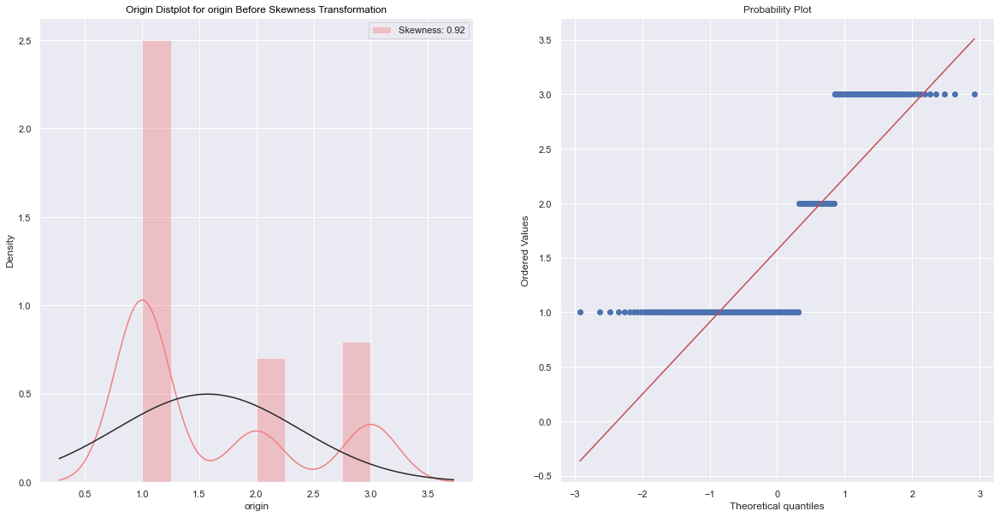

Skewness After Transformation for origin:  0.8142869610986857 

Mean before Transformation for Origin : 0.9729236582384831, Standard Deviation before Transformation for Origin : 0.33082758735263834 



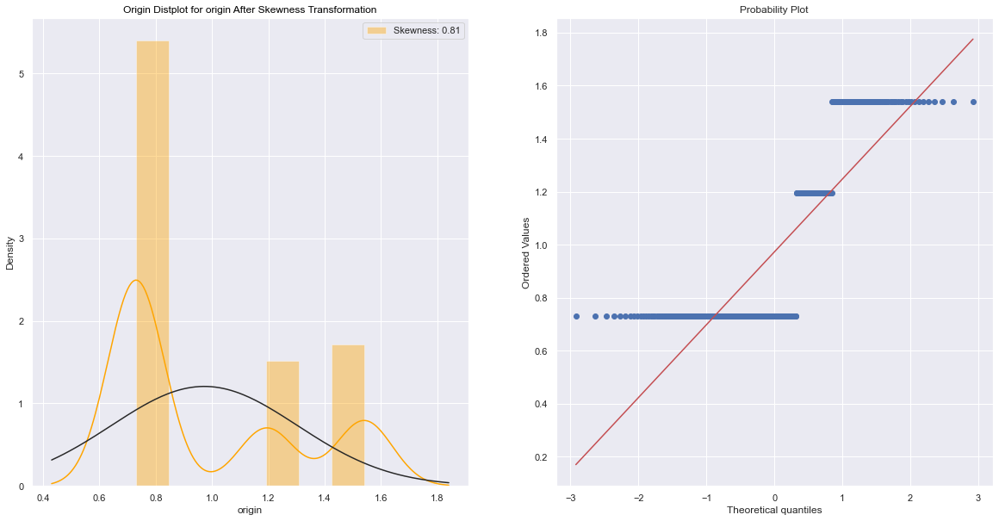

Skewness Before Transformation for disp:  0.7196451643005952 

Mean before Transformation for Disp : 193.42587939698493, Standard Deviation before Transformation for Disp : 104.13876352708573 



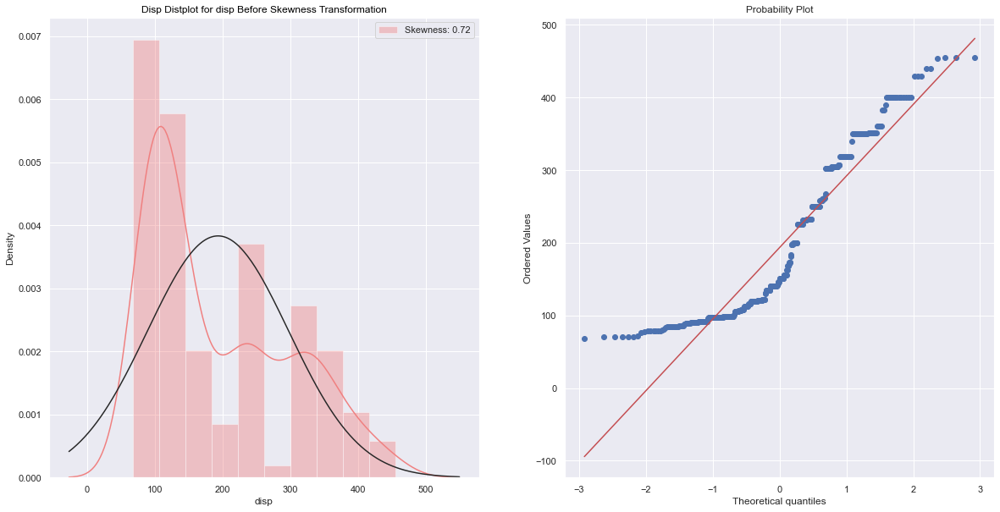

Skewness After Transformation for disp:  0.22888576783929218 

Mean before Transformation for Disp : 5.129939471346422, Standard Deviation before Transformation for Disp : 0.5274239931205971 



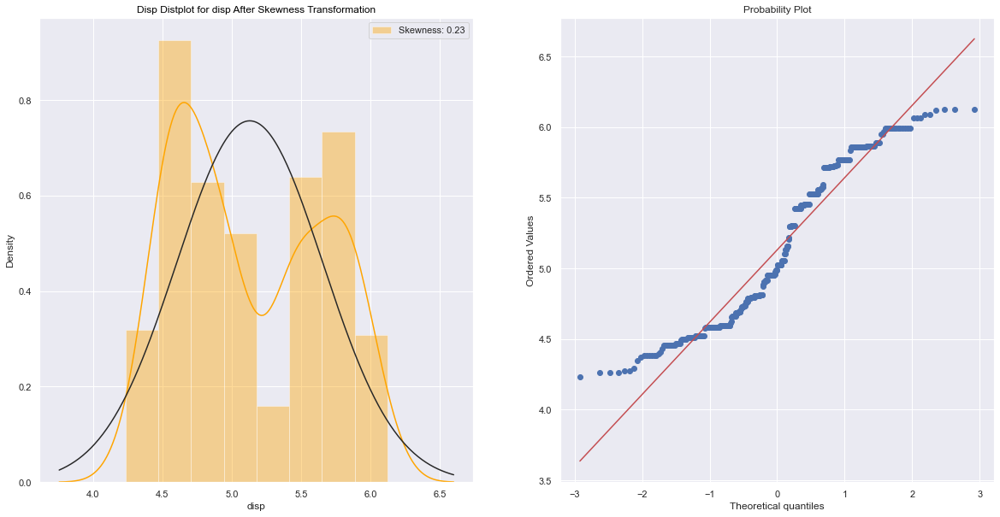

Skewness Before Transformation for wt:  0.5310625125994629 

Mean before Transformation for Wt : 2970.424623115578, Standard Deviation before Transformation for Wt : 845.7772335198174 



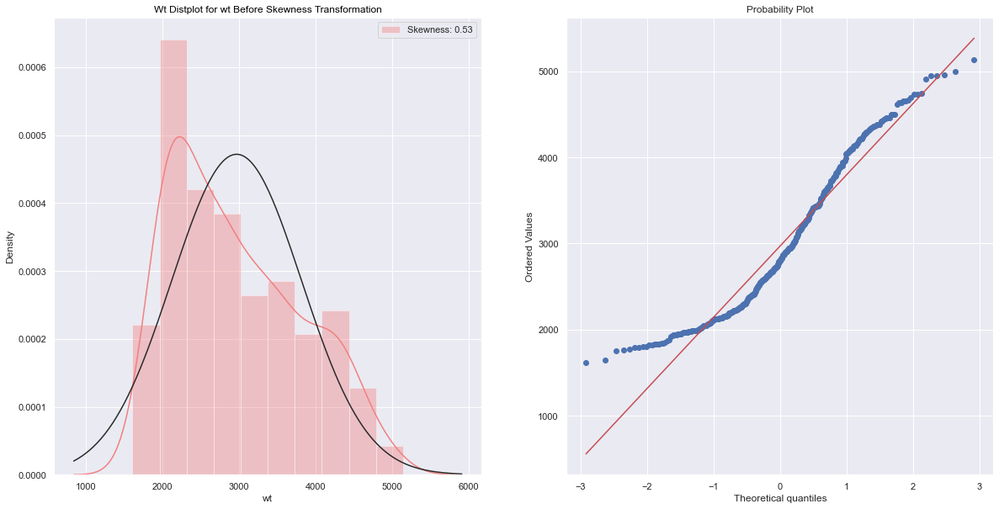

Skewness After Transformation for wt:  0.15643508284041371 

Mean before Transformation for Wt : 7.957254010490897, Standard Deviation before Transformation for Wt : 0.2802137303725529 



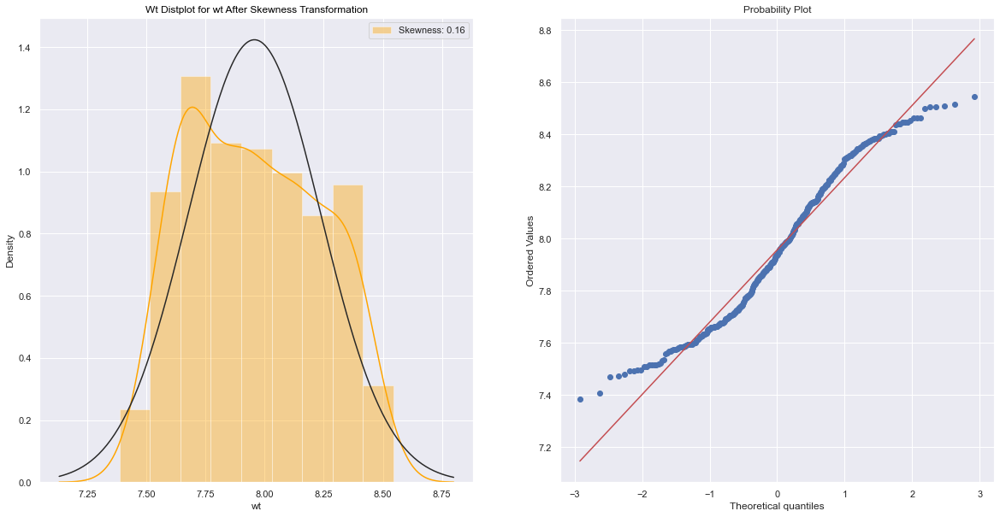

Skewness Before Transformation for cyl:  0.5269215453528939 

Mean before Transformation for Cyl : 5.454773869346734, Standard Deviation before Transformation for Cyl : 1.6988659605395604 



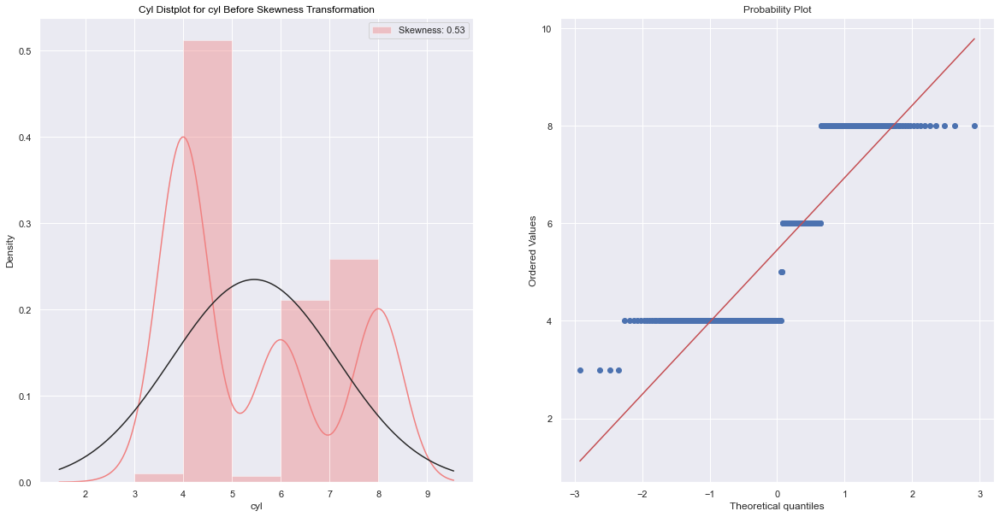

Skewness After Transformation for cyl:  0.3930033711425588 

Mean before Transformation for Cyl : 1.8316994320979822, Standard Deviation before Transformation for Cyl : 0.2542767757873721 



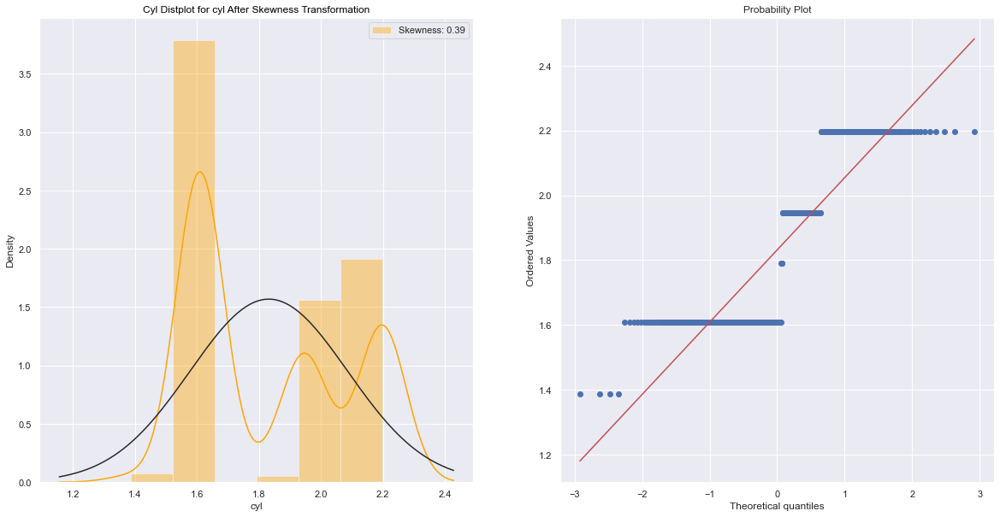

Skewness Before Transformation for mpg:  0.45706634399491913 

Mean before Transformation for Mpg : 23.514572864321607, Standard Deviation before Transformation for Mpg : 7.806159061274433 



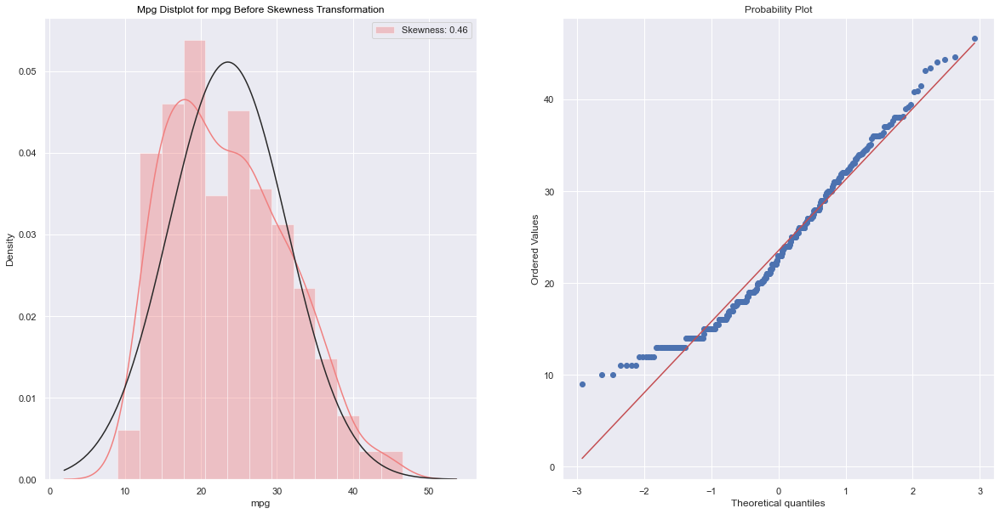

Skewness After Transformation for mpg:  -0.10913831720100581 

Mean before Transformation for Mpg : 3.1478302770344047, Standard Deviation before Transformation for Mpg : 0.32375928015327066 



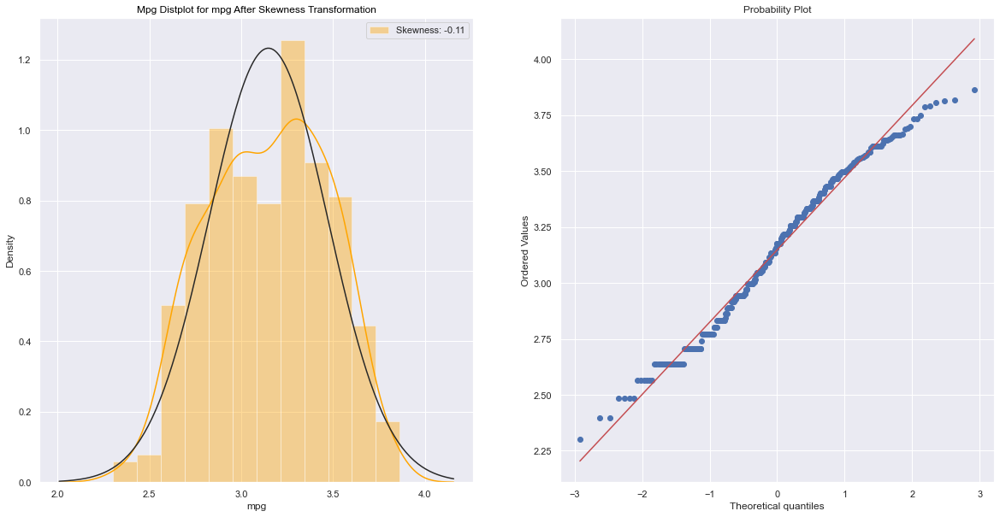

Skewness Before Transformation for acc:  0.27877684462588986 

Mean before Transformation for Acc : 15.568090452261307, Standard Deviation before Transformation for Acc : 2.7542223175940177 



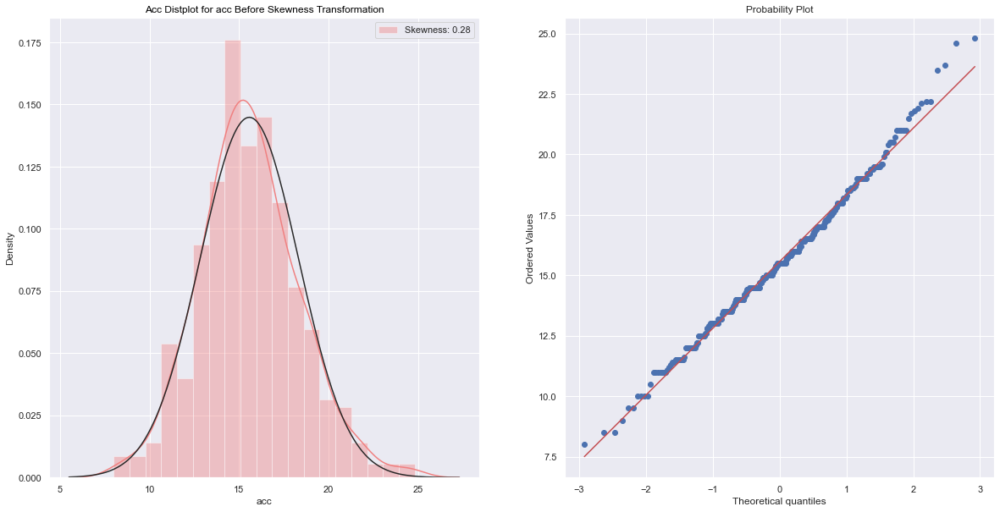

Skewness After Transformation for acc:  -0.3155766096458847 

Mean before Transformation for Acc : 2.793445164973402, Standard Deviation before Transformation for Acc : 0.16892714758791103 



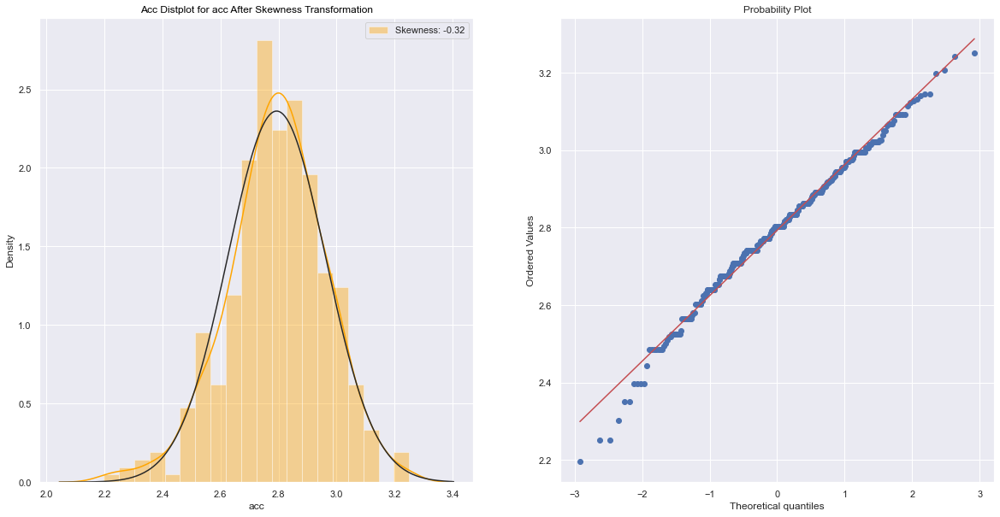

Skewness Before Transformation for yr:  0.01153459401509278 

Mean before Transformation for Yr : 76.01005025125629, Standard Deviation before Transformation for Yr : 3.6929784655780975 



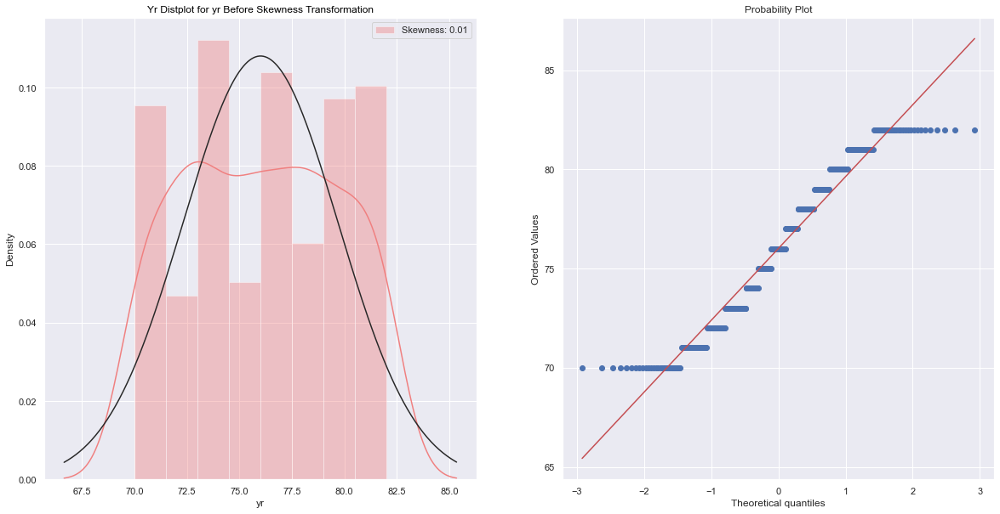

Skewness After Transformation for yr:  -0.04770128229674319 

Mean before Transformation for Yr : 4.342784131164792, Standard Deviation before Transformation for Yr : 0.04801962252153379 



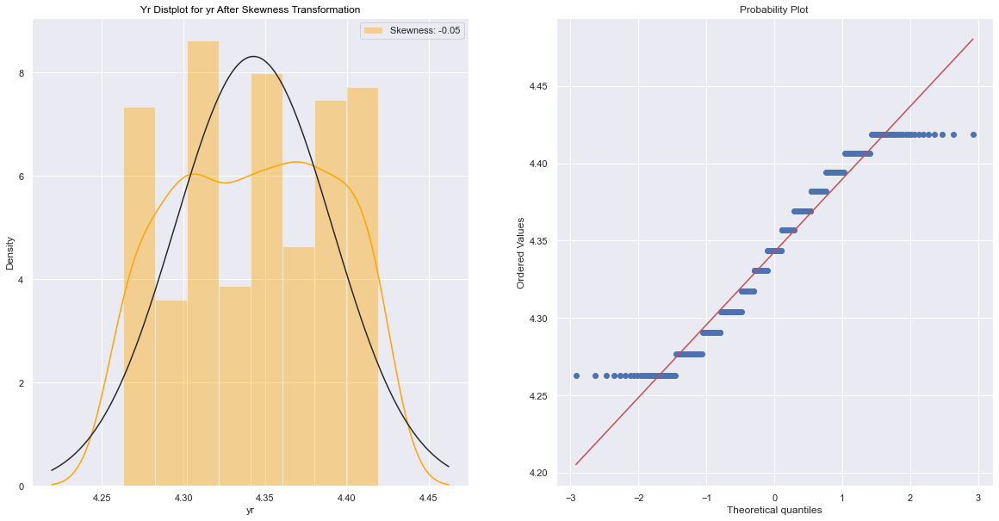

Elapsed Time:  6.327205181121826 seconds



In [73]:
from luciferml.preprocessing import Preprocess as prep
import pandas as pd
Auto_lin = pd.read_csv('mpg.csv')
Auto_lin = prep.skewcorrect(dataset)

In [74]:
from luciferml.supervised.regression import Regression
accuracy_scores =  {}
dataset = Auto_lin
feature = ['cyl','disp','wt','yr','acc','hp']
X = Auto_lin[feature]
y = Auto_lin['mpg']
regressor = Regression(predictor = 'bag')
regressor.fit(X, y)
result = regressor.result()


          
██╗░░░░░██╗░░░██╗░█████╗░██╗███████╗███████╗██████╗░░░░░░░███╗░░░███╗██╗░░░░░
██║░░░░░██║░░░██║██╔══██╗██║██╔════╝██╔════╝██╔══██╗░░░░░░████╗░████║██║░░░░░
██║░░░░░██║░░░██║██║░░╚═╝██║█████╗░░█████╗░░██████╔╝█████╗██╔████╔██║██║░░░░░
██║░░░░░██║░░░██║██║░░██╗██║██╔══╝░░██╔══╝░░██╔══██╗╚════╝██║╚██╔╝██║██║░░░░░
███████╗╚██████╔╝╚█████╔╝██║██║░░░░░███████╗██║░░██║░░░░░░██║░╚═╝░██║███████╗
╚══════╝░╚═════╝░░╚════╝░╚═╝╚═╝░░░░░╚══════╝╚═╝░░╚═╝░░░░░░╚═╝░░░░░╚═╝╚══════╝

Started Lucifer-ML 

Checking if labels or features are categorical! [*]

Features are Categorical

Encoding Features [*]

Encoding Features Done [ ✓ ]

Labels are not categorical [ ✓ ]

Checking for Categorical Variables Done [ ✓ ]

Checking for Sparse Matrix [*]

Converting Sparse Features to array []

Conversion of Sparse Features to array Done [ ✓ ]

Splitting Data into Train and Validation Sets [*]

Splitting Done [ ✓ ]

Scaling Training and Test Sets [*]

Scaling Done [ ✓ ]

Training Bagging Regressor on Tra

In [75]:
from luciferml.supervised.regression import Regression
accuracy_scores =  {}
dataset = Auto_lin
feature = ['cyl','disp','wt','yr','acc','hp']
X = Auto_lin[feature]
y = Auto_lin['mpg']
regressor = Regression(predictor = 'br')
regressor.fit(X, y)
result = regressor.result()


          
██╗░░░░░██╗░░░██╗░█████╗░██╗███████╗███████╗██████╗░░░░░░░███╗░░░███╗██╗░░░░░
██║░░░░░██║░░░██║██╔══██╗██║██╔════╝██╔════╝██╔══██╗░░░░░░████╗░████║██║░░░░░
██║░░░░░██║░░░██║██║░░╚═╝██║█████╗░░█████╗░░██████╔╝█████╗██╔████╔██║██║░░░░░
██║░░░░░██║░░░██║██║░░██╗██║██╔══╝░░██╔══╝░░██╔══██╗╚════╝██║╚██╔╝██║██║░░░░░
███████╗╚██████╔╝╚█████╔╝██║██║░░░░░███████╗██║░░██║░░░░░░██║░╚═╝░██║███████╗
╚══════╝░╚═════╝░░╚════╝░╚═╝╚═╝░░░░░╚══════╝╚═╝░░╚═╝░░░░░░╚═╝░░░░░╚═╝╚══════╝

Started Lucifer-ML 

Checking if labels or features are categorical! [*]

Features are Categorical

Encoding Features [*]

Encoding Features Done [ ✓ ]

Labels are not categorical [ ✓ ]

Checking for Categorical Variables Done [ ✓ ]

Checking for Sparse Matrix [*]

Converting Sparse Features to array []

Conversion of Sparse Features to array Done [ ✓ ]

Splitting Data into Train and Validation Sets [*]

Splitting Done [ ✓ ]

Scaling Training and Test Sets [*]

Scaling Done [ ✓ ]

Training BayesianRidge Regressor 

In [76]:
from luciferml.supervised.regression import Regression
accuracy_scores =  {}
dataset = Auto_lin
feature = ['cyl','disp','wt','yr','acc','hp']
X = Auto_lin[feature]
y = Auto_lin['mpg']
regressor = Regression(predictor = 'svr')
regressor.fit(X, y)
result = regressor.result()


          
██╗░░░░░██╗░░░██╗░█████╗░██╗███████╗███████╗██████╗░░░░░░░███╗░░░███╗██╗░░░░░
██║░░░░░██║░░░██║██╔══██╗██║██╔════╝██╔════╝██╔══██╗░░░░░░████╗░████║██║░░░░░
██║░░░░░██║░░░██║██║░░╚═╝██║█████╗░░█████╗░░██████╔╝█████╗██╔████╔██║██║░░░░░
██║░░░░░██║░░░██║██║░░██╗██║██╔══╝░░██╔══╝░░██╔══██╗╚════╝██║╚██╔╝██║██║░░░░░
███████╗╚██████╔╝╚█████╔╝██║██║░░░░░███████╗██║░░██║░░░░░░██║░╚═╝░██║███████╗
╚══════╝░╚═════╝░░╚════╝░╚═╝╚═╝░░░░░╚══════╝╚═╝░░╚═╝░░░░░░╚═╝░░░░░╚═╝╚══════╝

Started Lucifer-ML 

Checking if labels or features are categorical! [*]

Features are Categorical

Encoding Features [*]

Encoding Features Done [ ✓ ]

Labels are not categorical [ ✓ ]

Checking for Categorical Variables Done [ ✓ ]

Checking for Sparse Matrix [*]

Converting Sparse Features to array []

Conversion of Sparse Features to array Done [ ✓ ]

Splitting Data into Train and Validation Sets [*]

Splitting Done [ ✓ ]

Scaling Training and Test Sets [*]

Scaling Done [ ✓ ]

Training Support Vector Machine o

In [77]:
from luciferml.supervised.regression import Regression
accuracy_scores =  {}
dataset = Auto_lin
feature = ['cyl','disp','wt','yr','acc','hp']
X = Auto_lin[feature]
y = Auto_lin['mpg']
regressor = Regression(predictor = 'cat')
regressor.fit(X, y)
result = regressor.result()


          
██╗░░░░░██╗░░░██╗░█████╗░██╗███████╗███████╗██████╗░░░░░░░███╗░░░███╗██╗░░░░░
██║░░░░░██║░░░██║██╔══██╗██║██╔════╝██╔════╝██╔══██╗░░░░░░████╗░████║██║░░░░░
██║░░░░░██║░░░██║██║░░╚═╝██║█████╗░░█████╗░░██████╔╝█████╗██╔████╔██║██║░░░░░
██║░░░░░██║░░░██║██║░░██╗██║██╔══╝░░██╔══╝░░██╔══██╗╚════╝██║╚██╔╝██║██║░░░░░
███████╗╚██████╔╝╚█████╔╝██║██║░░░░░███████╗██║░░██║░░░░░░██║░╚═╝░██║███████╗
╚══════╝░╚═════╝░░╚════╝░╚═╝╚═╝░░░░░╚══════╝╚═╝░░╚═╝░░░░░░╚═╝░░░░░╚═╝╚══════╝

Started Lucifer-ML 

Checking if labels or features are categorical! [*]

Features are Categorical

Encoding Features [*]

Encoding Features Done [ ✓ ]

Labels are not categorical [ ✓ ]

Checking for Categorical Variables Done [ ✓ ]

Checking for Sparse Matrix [*]

Converting Sparse Features to array []

Conversion of Sparse Features to array Done [ ✓ ]

Splitting Data into Train and Validation Sets [*]

Splitting Done [ ✓ ]

Scaling Training and Test Sets [*]

Scaling Done [ ✓ ]

Training CatBoost Regressor on Tr

Regression with Heirarchical clusters

In [78]:
dataset = Hclus
feature = ['cyl','disp','wt','yr','acc']
X = Hclus[feature]
y = Hclus['mpg']
regressor = Regression(predictor = 'bag')
regressor.fit(X, y)
result = regressor.result()


          
██╗░░░░░██╗░░░██╗░█████╗░██╗███████╗███████╗██████╗░░░░░░░███╗░░░███╗██╗░░░░░
██║░░░░░██║░░░██║██╔══██╗██║██╔════╝██╔════╝██╔══██╗░░░░░░████╗░████║██║░░░░░
██║░░░░░██║░░░██║██║░░╚═╝██║█████╗░░█████╗░░██████╔╝█████╗██╔████╔██║██║░░░░░
██║░░░░░██║░░░██║██║░░██╗██║██╔══╝░░██╔══╝░░██╔══██╗╚════╝██║╚██╔╝██║██║░░░░░
███████╗╚██████╔╝╚█████╔╝██║██║░░░░░███████╗██║░░██║░░░░░░██║░╚═╝░██║███████╗
╚══════╝░╚═════╝░░╚════╝░╚═╝╚═╝░░░░░╚══════╝╚═╝░░╚═╝░░░░░░╚═╝░░░░░╚═╝╚══════╝

Started Lucifer-ML 

Checking if labels or features are categorical! [*]

Features are not categorical [ ✓ ]

Labels are not categorical [ ✓ ]

Checking for Categorical Variables Done [ ✓ ]

Checking for Sparse Matrix [*]

Splitting Data into Train and Validation Sets [*]

Splitting Done [ ✓ ]

Scaling Training and Test Sets [*]

Scaling Done [ ✓ ]

Training Bagging Regressor on Training Set [*]

Model Training Done [ ✓ ]

Predicting Data [*]

Data Prediction Done [ ✓ ]

Evaluating Model Performance [*]
Validation

In [79]:
dataset = Hclus
feature = ['cyl','disp','wt','yr','acc']
X = Hclus[feature]
y = Hclus['mpg']
regressor = Regression(predictor = 'br')
regressor.fit(X, y)
result = regressor.result()


          
██╗░░░░░██╗░░░██╗░█████╗░██╗███████╗███████╗██████╗░░░░░░░███╗░░░███╗██╗░░░░░
██║░░░░░██║░░░██║██╔══██╗██║██╔════╝██╔════╝██╔══██╗░░░░░░████╗░████║██║░░░░░
██║░░░░░██║░░░██║██║░░╚═╝██║█████╗░░█████╗░░██████╔╝█████╗██╔████╔██║██║░░░░░
██║░░░░░██║░░░██║██║░░██╗██║██╔══╝░░██╔══╝░░██╔══██╗╚════╝██║╚██╔╝██║██║░░░░░
███████╗╚██████╔╝╚█████╔╝██║██║░░░░░███████╗██║░░██║░░░░░░██║░╚═╝░██║███████╗
╚══════╝░╚═════╝░░╚════╝░╚═╝╚═╝░░░░░╚══════╝╚═╝░░╚═╝░░░░░░╚═╝░░░░░╚═╝╚══════╝

Started Lucifer-ML 

Checking if labels or features are categorical! [*]

Features are not categorical [ ✓ ]

Labels are not categorical [ ✓ ]

Checking for Categorical Variables Done [ ✓ ]

Checking for Sparse Matrix [*]

Splitting Data into Train and Validation Sets [*]

Splitting Done [ ✓ ]

Scaling Training and Test Sets [*]

Scaling Done [ ✓ ]

Training BayesianRidge Regressor on Training Set [*]

Model Training Done [ ✓ ]

Predicting Data [*]

Data Prediction Done [ ✓ ]

Evaluating Model Performance [*]
Vali

In [80]:
dataset = Hclus
feature = ['cyl','disp','wt','yr','acc']
X = Hclus[feature]
y = Hclus['mpg']
regressor = Regression(predictor = 'svr')
regressor.fit(X, y)
result = regressor.result()


          
██╗░░░░░██╗░░░██╗░█████╗░██╗███████╗███████╗██████╗░░░░░░░███╗░░░███╗██╗░░░░░
██║░░░░░██║░░░██║██╔══██╗██║██╔════╝██╔════╝██╔══██╗░░░░░░████╗░████║██║░░░░░
██║░░░░░██║░░░██║██║░░╚═╝██║█████╗░░█████╗░░██████╔╝█████╗██╔████╔██║██║░░░░░
██║░░░░░██║░░░██║██║░░██╗██║██╔══╝░░██╔══╝░░██╔══██╗╚════╝██║╚██╔╝██║██║░░░░░
███████╗╚██████╔╝╚█████╔╝██║██║░░░░░███████╗██║░░██║░░░░░░██║░╚═╝░██║███████╗
╚══════╝░╚═════╝░░╚════╝░╚═╝╚═╝░░░░░╚══════╝╚═╝░░╚═╝░░░░░░╚═╝░░░░░╚═╝╚══════╝

Started Lucifer-ML 

Checking if labels or features are categorical! [*]

Features are not categorical [ ✓ ]

Labels are not categorical [ ✓ ]

Checking for Categorical Variables Done [ ✓ ]

Checking for Sparse Matrix [*]

Splitting Data into Train and Validation Sets [*]

Splitting Done [ ✓ ]

Scaling Training and Test Sets [*]

Scaling Done [ ✓ ]

Training Support Vector Machine on Training Set [*]

Model Training Done [ ✓ ]

Predicting Data [*]

Data Prediction Done [ ✓ ]

Evaluating Model Performance [*]
Valid

In [81]:
dataset = Hclus
feature = ['cyl','disp','wt','yr','acc']
X = Hclus[feature]
y = Hclus['mpg']
regressor = Regression(predictor = 'cat')
regressor.fit(X, y)
result = regressor.result()


          
██╗░░░░░██╗░░░██╗░█████╗░██╗███████╗███████╗██████╗░░░░░░░███╗░░░███╗██╗░░░░░
██║░░░░░██║░░░██║██╔══██╗██║██╔════╝██╔════╝██╔══██╗░░░░░░████╗░████║██║░░░░░
██║░░░░░██║░░░██║██║░░╚═╝██║█████╗░░█████╗░░██████╔╝█████╗██╔████╔██║██║░░░░░
██║░░░░░██║░░░██║██║░░██╗██║██╔══╝░░██╔══╝░░██╔══██╗╚════╝██║╚██╔╝██║██║░░░░░
███████╗╚██████╔╝╚█████╔╝██║██║░░░░░███████╗██║░░██║░░░░░░██║░╚═╝░██║███████╗
╚══════╝░╚═════╝░░╚════╝░╚═╝╚═╝░░░░░╚══════╝╚═╝░░╚═╝░░░░░░╚═╝░░░░░╚═╝╚══════╝

Started Lucifer-ML 

Checking if labels or features are categorical! [*]

Features are not categorical [ ✓ ]

Labels are not categorical [ ✓ ]

Checking for Categorical Variables Done [ ✓ ]

Checking for Sparse Matrix [*]

Splitting Data into Train and Validation Sets [*]

Splitting Done [ ✓ ]

Scaling Training and Test Sets [*]

Scaling Done [ ✓ ]

Training CatBoost Regressor on Training Set [*]

Model Training Done [ ✓ ]

Predicting Data [*]

Data Prediction Done [ ✓ ]

Evaluating Model Performance [*]
Validatio

Regression with Kmeans clusters

In [82]:
kmeans = pd.read_csv('kmeans.csv')
feature = ['cyl','disp','wt','yr','acc']
X = kmeans_data[feature]
y = kmeans_data['mpg']
regressor = Regression(predictor = 'bag')
regressor.fit(X, y)
result = regressor.result()


          
██╗░░░░░██╗░░░██╗░█████╗░██╗███████╗███████╗██████╗░░░░░░░███╗░░░███╗██╗░░░░░
██║░░░░░██║░░░██║██╔══██╗██║██╔════╝██╔════╝██╔══██╗░░░░░░████╗░████║██║░░░░░
██║░░░░░██║░░░██║██║░░╚═╝██║█████╗░░█████╗░░██████╔╝█████╗██╔████╔██║██║░░░░░
██║░░░░░██║░░░██║██║░░██╗██║██╔══╝░░██╔══╝░░██╔══██╗╚════╝██║╚██╔╝██║██║░░░░░
███████╗╚██████╔╝╚█████╔╝██║██║░░░░░███████╗██║░░██║░░░░░░██║░╚═╝░██║███████╗
╚══════╝░╚═════╝░░╚════╝░╚═╝╚═╝░░░░░╚══════╝╚═╝░░╚═╝░░░░░░╚═╝░░░░░╚═╝╚══════╝

Started Lucifer-ML 

Checking if labels or features are categorical! [*]

Features are not categorical [ ✓ ]

Labels are not categorical [ ✓ ]

Checking for Categorical Variables Done [ ✓ ]

Checking for Sparse Matrix [*]

Splitting Data into Train and Validation Sets [*]

Splitting Done [ ✓ ]

Scaling Training and Test Sets [*]

Scaling Done [ ✓ ]

Training Bagging Regressor on Training Set [*]

Model Training Done [ ✓ ]

Predicting Data [*]

Data Prediction Done [ ✓ ]

Evaluating Model Performance [*]
Validation

In [83]:
kmeans = pd.read_csv('kmeans.csv')
feature = ['cyl','disp','wt','yr','acc']
X = kmeans_data[feature]
y = kmeans_data['mpg']
regressor = Regression(predictor = 'br')
regressor.fit(X, y)
result = regressor.result()


          
██╗░░░░░██╗░░░██╗░█████╗░██╗███████╗███████╗██████╗░░░░░░░███╗░░░███╗██╗░░░░░
██║░░░░░██║░░░██║██╔══██╗██║██╔════╝██╔════╝██╔══██╗░░░░░░████╗░████║██║░░░░░
██║░░░░░██║░░░██║██║░░╚═╝██║█████╗░░█████╗░░██████╔╝█████╗██╔████╔██║██║░░░░░
██║░░░░░██║░░░██║██║░░██╗██║██╔══╝░░██╔══╝░░██╔══██╗╚════╝██║╚██╔╝██║██║░░░░░
███████╗╚██████╔╝╚█████╔╝██║██║░░░░░███████╗██║░░██║░░░░░░██║░╚═╝░██║███████╗
╚══════╝░╚═════╝░░╚════╝░╚═╝╚═╝░░░░░╚══════╝╚═╝░░╚═╝░░░░░░╚═╝░░░░░╚═╝╚══════╝

Started Lucifer-ML 

Checking if labels or features are categorical! [*]

Features are not categorical [ ✓ ]

Labels are not categorical [ ✓ ]

Checking for Categorical Variables Done [ ✓ ]

Checking for Sparse Matrix [*]

Splitting Data into Train and Validation Sets [*]

Splitting Done [ ✓ ]

Scaling Training and Test Sets [*]

Scaling Done [ ✓ ]

Training BayesianRidge Regressor on Training Set [*]

Model Training Done [ ✓ ]

Predicting Data [*]

Data Prediction Done [ ✓ ]

Evaluating Model Performance [*]
Vali

In [84]:
kmeans = pd.read_csv('kmeans.csv')
feature = ['cyl','disp','wt','yr','acc']
X = kmeans_data[feature]
y = kmeans_data['mpg']
regressor = Regression(predictor = 'svr')
regressor.fit(X, y)
result = regressor.result()


          
██╗░░░░░██╗░░░██╗░█████╗░██╗███████╗███████╗██████╗░░░░░░░███╗░░░███╗██╗░░░░░
██║░░░░░██║░░░██║██╔══██╗██║██╔════╝██╔════╝██╔══██╗░░░░░░████╗░████║██║░░░░░
██║░░░░░██║░░░██║██║░░╚═╝██║█████╗░░█████╗░░██████╔╝█████╗██╔████╔██║██║░░░░░
██║░░░░░██║░░░██║██║░░██╗██║██╔══╝░░██╔══╝░░██╔══██╗╚════╝██║╚██╔╝██║██║░░░░░
███████╗╚██████╔╝╚█████╔╝██║██║░░░░░███████╗██║░░██║░░░░░░██║░╚═╝░██║███████╗
╚══════╝░╚═════╝░░╚════╝░╚═╝╚═╝░░░░░╚══════╝╚═╝░░╚═╝░░░░░░╚═╝░░░░░╚═╝╚══════╝

Started Lucifer-ML 

Checking if labels or features are categorical! [*]

Features are not categorical [ ✓ ]

Labels are not categorical [ ✓ ]

Checking for Categorical Variables Done [ ✓ ]

Checking for Sparse Matrix [*]

Splitting Data into Train and Validation Sets [*]

Splitting Done [ ✓ ]

Scaling Training and Test Sets [*]

Scaling Done [ ✓ ]

Training Support Vector Machine on Training Set [*]

Model Training Done [ ✓ ]

Predicting Data [*]

Data Prediction Done [ ✓ ]

Evaluating Model Performance [*]
Valid

In [85]:
kmeans = pd.read_csv('kmeans.csv')
feature = ['cyl','disp','wt','yr','acc']
X = kmeans_data[feature]
y = kmeans_data['mpg']
regressor = Regression(predictor = 'cat')
regressor.fit(X, y)
result = regressor.result()


          
██╗░░░░░██╗░░░██╗░█████╗░██╗███████╗███████╗██████╗░░░░░░░███╗░░░███╗██╗░░░░░
██║░░░░░██║░░░██║██╔══██╗██║██╔════╝██╔════╝██╔══██╗░░░░░░████╗░████║██║░░░░░
██║░░░░░██║░░░██║██║░░╚═╝██║█████╗░░█████╗░░██████╔╝█████╗██╔████╔██║██║░░░░░
██║░░░░░██║░░░██║██║░░██╗██║██╔══╝░░██╔══╝░░██╔══██╗╚════╝██║╚██╔╝██║██║░░░░░
███████╗╚██████╔╝╚█████╔╝██║██║░░░░░███████╗██║░░██║░░░░░░██║░╚═╝░██║███████╗
╚══════╝░╚═════╝░░╚════╝░╚═╝╚═╝░░░░░╚══════╝╚═╝░░╚═╝░░░░░░╚═╝░░░░░╚═╝╚══════╝

Started Lucifer-ML 

Checking if labels or features are categorical! [*]

Features are not categorical [ ✓ ]

Labels are not categorical [ ✓ ]

Checking for Categorical Variables Done [ ✓ ]

Checking for Sparse Matrix [*]

Splitting Data into Train and Validation Sets [*]

Splitting Done [ ✓ ]

Scaling Training and Test Sets [*]

Scaling Done [ ✓ ]

Training CatBoost Regressor on Training Set [*]

Model Training Done [ ✓ ]

Predicting Data [*]

Data Prediction Done [ ✓ ]

Evaluating Model Performance [*]
Validatio

5&6. The regression models has been generated with original data, Hierarchial clusters and Kmeans clusters. The four regression models used in the project are namely Bayesian Ridge Regressor, Support Vector Regressor, Bagging Regressor and Catboost Regressor.

"Kmeans clusters with Cat boost regressor has highest R2 score of 88.3%"

The inference from data anaylsis plots show that Miles per gallon has improved over the years due to constant innovation in car industry or construction of new roads in the city (which might have reduced the traffic). 

    To improve the dataset it would be beneficial to given details on fuel price data over the years and average kilometers driven.

# Part2 : Wine Quality

In [1]:
from sdv.tabular import GaussianCopula
import pandas as pd 
import numpy as np

In [2]:
real_data = pd.read_csv('Company.csv')

In [3]:
import warnings
warnings.filterwarnings("ignore")
model = GaussianCopula()
model.fit(real_data)
synthetic_data = model.sample()

In [4]:
real_data.head()

,A,B,C,D,Quality
0,32,88,98,101,Quality A
1,168,137,167,181,Quality B
2,149,145,154,144,NaN
3,96,33,27,31,Quality A
4,13,76,102,94,Quality A


In [5]:
synthetic_data.head()

,A,B,C,D,Quality
0,197,197,199,195,Quality B
1,34,64,64,14,Quality A
2,157,98,13,50,Quality B
3,155,149,122,155,Quality B
4,15,28,13,4,Quality A


In [6]:
from sdv.evaluation import evaluate

evaluate(synthetic_data, real_data)

0.5499799634809122

In [7]:
evaluate(synthetic_data, real_data, aggregate=False)

,metric,name,raw_score,normalized_score,min_value,max_value,goal
1,LogisticDetection,LogisticRegression Detection,0.736032,7.360317e-01,0.0,1.0,MAXIMIZE
2,SVCDetection,SVC Detection,0.555952,5.559524e-01,0.0,1.0,MAXIMIZE
11,GMLogLikelihood,GaussianMixture Log Likelihood,-52.198297,2.140759e-23,-inf,inf,MAXIMIZE
12,CSTest,Chi-Squared,0.801452,8.014521e-01,0.0,1.0,MAXIMIZE
13,KSTest,Inverted Kolmogorov-Smirnov D statistic,0.860656,8.606557e-01,0.0,1.0,MAXIMIZE
14,KSTestExtended,Inverted Kolmogorov-Smirnov D statistic,0.852459,8.524590e-01,0.0,1.0,MAXIMIZE
27,ContinuousKLDivergence,Continuous Kullback–Leibler Divergence,0.148706,1.487055e-01,0.0,1.0,MAXIMIZE


In [8]:
evaluate(synthetic_data, real_data, metrics=['CSTest', 'KSTest'])

0.8310539395438277


          
██╗░░░░░██╗░░░██╗░█████╗░██╗███████╗███████╗██████╗░░░░░░░███╗░░░███╗██╗░░░░░
██║░░░░░██║░░░██║██╔══██╗██║██╔════╝██╔════╝██╔══██╗░░░░░░████╗░████║██║░░░░░
██║░░░░░██║░░░██║██║░░╚═╝██║█████╗░░█████╗░░██████╔╝█████╗██╔████╔██║██║░░░░░
██║░░░░░██║░░░██║██║░░██╗██║██╔══╝░░██╔══╝░░██╔══██╗╚════╝██║╚██╔╝██║██║░░░░░
███████╗╚██████╔╝╚█████╔╝██║██║░░░░░███████╗██║░░██║░░░░░░██║░╚═╝░██║███████╗
╚══════╝░╚═════╝░░╚════╝░╚═╝╚═╝░░░░░╚══════╝╚═╝░░╚═╝░░░░░░╚═╝░░░░░╚═╝╚══════╝

Started LuciferML 

Checking if labels or features are categorical! [*]

Features are not categorical [ ✓ ]

Labels are Categorical [*] 

Encoding Labels 

Encoding Labels Done [ ✓ ]

Checking for Categorical Variables Done [ ✓ ]

Checking for Sparse Matrix [*]

Splitting Data into Train and Validation Sets [*]

Splitting Done [ ✓ ]

Scaling Training and Test Sets [*]

Scaling Done [ ✓ ]

Training Logistic Regression on Training Set [*]

Model Training Done [ ✓ ]

Predicting Data [*]

Data Prediction Done [ ✓ ]

M

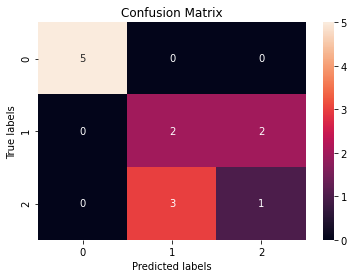

Confusion Matrix Done [ ✓ ]

Evaluating Model Performance [*]
Validation Accuracy is : 0.6153846153846154
Evaluating Model Performance [ ✓ ]

Applying K-Fold Cross Validation [*]
Accuracy: 64.00 %
Standard Deviation: 14.28 %
K-Fold Cross Validation [ ✓ ]

Complete [ ✓ ]

Time Elapsed :  0.550457239151001 seconds 



In [9]:
from luciferml.supervised.classification import Classification
accuracy_scores =  {}
feature = ['A','B','C','D']
X = real_data[feature]
y = real_data['Quality']
classifier = Classification(predictor = 'lr')
classifier.fit(X, y)
result = classifier.result()


          
██╗░░░░░██╗░░░██╗░█████╗░██╗███████╗███████╗██████╗░░░░░░░███╗░░░███╗██╗░░░░░
██║░░░░░██║░░░██║██╔══██╗██║██╔════╝██╔════╝██╔══██╗░░░░░░████╗░████║██║░░░░░
██║░░░░░██║░░░██║██║░░╚═╝██║█████╗░░█████╗░░██████╔╝█████╗██╔████╔██║██║░░░░░
██║░░░░░██║░░░██║██║░░██╗██║██╔══╝░░██╔══╝░░██╔══██╗╚════╝██║╚██╔╝██║██║░░░░░
███████╗╚██████╔╝╚█████╔╝██║██║░░░░░███████╗██║░░██║░░░░░░██║░╚═╝░██║███████╗
╚══════╝░╚═════╝░░╚════╝░╚═╝╚═╝░░░░░╚══════╝╚═╝░░╚═╝░░░░░░╚═╝░░░░░╚═╝╚══════╝

Started LuciferML 

Checking if labels or features are categorical! [*]

Features are not categorical [ ✓ ]

Labels are Categorical [*] 

Encoding Labels 

Encoding Labels Done [ ✓ ]

Checking for Categorical Variables Done [ ✓ ]

Checking for Sparse Matrix [*]

Splitting Data into Train and Validation Sets [*]

Splitting Done [ ✓ ]

Scaling Training and Test Sets [*]

Scaling Done [ ✓ ]

Training Logistic Regression on Training Set [*]

Model Training Done [ ✓ ]

Predicting Data [*]

Data Prediction Done [ ✓ ]

M

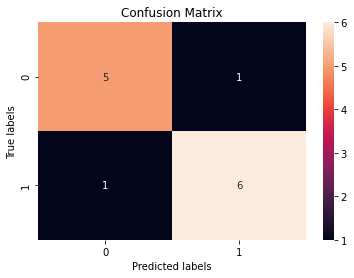

Confusion Matrix Done [ ✓ ]

Evaluating Model Performance [*]
Validation Accuracy is : 0.8461538461538461
Evaluating Model Performance [ ✓ ]

Applying K-Fold Cross Validation [*]
Accuracy: 75.00 %
Standard Deviation: 24.19 %
K-Fold Cross Validation [ ✓ ]

Complete [ ✓ ]

Time Elapsed :  0.34400057792663574 seconds 



In [10]:
feature = ['A','B','C','D']
X = synthetic_data[feature]
y = synthetic_data['Quality']
classifier = Classification(predictor = 'lr')
classifier.fit(X, y)
result = classifier.result()

After applying the GaussianCopula model the data accuracy has increased. The accuracy scores has been generated using logistic regression.

# Part3 : Automobile : PCA

In [11]:
import h2o
from h2o.estimators import H2OPrincipalComponentAnalysisEstimator
h2o.init()

Checking whether there is an H2O instance running at http://localhost:54321 . connected.


H2O_cluster_uptime:,25 mins 57 secs
H2O_cluster_timezone:,Asia/Kolkata
H2O_data_parsing_timezone:,UTC
H2O_cluster_version:,3.34.0.3
H2O_cluster_version_age:,1 month and 13 days
H2O_cluster_name:,H2O_from_python_Admin_95j8sn
H2O_cluster_total_nodes:,1
H2O_cluster_free_memory:,1.444 Gb
H2O_cluster_total_cores:,8
H2O_cluster_allowed_cores:,8
H2O_cluster_status:,"locked, healthy"


In [12]:
import pandas as pd 
import numpy as np 
import seaborn as sns
import matplotlib.pyplot as plt 
from collections import Counter
from sklearn.model_selection import train_test_split
import plotly.graph_objects as go
import plotly.express as px
from luciferml.supervised import classification as cls

Data

In [13]:
gm = pd.read_csv('Part3 - vehicle.csv')
print(gm.shape)
gm.head()

(846, 19)


,compactness,circularity,distance_circularity,radius_ratio,pr.axis_aspect_ratio,max.length_aspect_ratio,scatter_ratio,elongatedness,pr.axis_rectangularity,max.length_rectangularity,scaled_variance,scaled_variance.1,scaled_radius_of_gyration,scaled_radius_of_gyration.1,skewness_about,skewness_about.1,skewness_about.2,hollows_ratio,class
0,95,48.0,83.0,178.0,72.0,10,162.0,42.0,20.0,159,176.0,379.0,184.0,70.0,6.0,16.0,187.0,197,van
1,91,41.0,84.0,141.0,57.0,9,149.0,45.0,19.0,143,170.0,330.0,158.0,72.0,9.0,14.0,189.0,199,van
2,104,50.0,106.0,209.0,66.0,10,207.0,32.0,23.0,158,223.0,635.0,220.0,73.0,14.0,9.0,188.0,196,car
3,93,41.0,82.0,159.0,63.0,9,144.0,46.0,19.0,143,160.0,309.0,127.0,63.0,6.0,10.0,199.0,207,van
4,85,44.0,70.0,205.0,103.0,52,149.0,45.0,19.0,144,241.0,325.0,188.0,127.0,9.0,11.0,180.0,183,bus


EDA and visualisation

In [14]:
print(gm.isnull().sum())

compactness                    0
circularity                    5
distance_circularity           4
radius_ratio                   6
pr.axis_aspect_ratio           2
max.length_aspect_ratio        0
scatter_ratio                  1
elongatedness                  1
pr.axis_rectangularity         3
max.length_rectangularity      0
scaled_variance                3
scaled_variance.1              2
scaled_radius_of_gyration      2
scaled_radius_of_gyration.1    4
skewness_about                 6
skewness_about.1               1
skewness_about.2               1
hollows_ratio                  0
class                          0
dtype: int64


In [15]:
for cols in gm.columns:
    if(cols != 'class'): 
        gm[cols] = gm[cols].fillna(gm[cols].median())

In [16]:
print(gm.isnull().sum())

compactness                    0
circularity                    0
distance_circularity           0
radius_ratio                   0
pr.axis_aspect_ratio           0
max.length_aspect_ratio        0
scatter_ratio                  0
elongatedness                  0
pr.axis_rectangularity         0
max.length_rectangularity      0
scaled_variance                0
scaled_variance.1              0
scaled_radius_of_gyration      0
scaled_radius_of_gyration.1    0
skewness_about                 0
skewness_about.1               0
skewness_about.2               0
hollows_ratio                  0
class                          0
dtype: int64


In [17]:
gm.describe().T.style.bar(
    subset=['mean'],
    color='Reds').background_gradient(
    subset=['std'], cmap='ocean').background_gradient(subset=['50%'], cmap='PuBu')

,count,mean,std,min,25%,50%,75%,max
compactness,846.000000,93.678487,8.234474,73.000000,87.000000,93.000000,100.000000,119.000000
circularity,846.000000,44.823877,6.134272,33.000000,40.000000,44.000000,49.000000,59.000000
distance_circularity,846.000000,82.100473,15.741569,40.000000,70.000000,80.000000,98.000000,112.000000
radius_ratio,846.000000,168.874704,33.401356,104.000000,141.000000,167.000000,195.000000,333.000000
pr.axis_aspect_ratio,846.000000,61.677305,7.882188,47.000000,57.000000,61.000000,65.000000,138.000000
max.length_aspect_ratio,846.000000,8.567376,4.601217,2.000000,7.000000,8.000000,10.000000,55.000000
scatter_ratio,846.000000,168.887707,33.197710,112.000000,147.000000,157.000000,198.000000,265.000000
elongatedness,846.000000,40.936170,7.811882,26.000000,33.000000,43.000000,46.000000,61.000000
pr.axis_rectangularity,846.000000,20.580378,2.588558,17.000000,19.000000,20.000000,23.000000,29.000000
max.length_rectangularity,846.000000,147.998818,14.515652,118.000000,137.000000,146.000000,159.000000,188.000000


In [18]:
def boxhistplot(columns,data):
    fig = px.histogram(gm, x = gm[column], color = 'class')
    fig.show()
    fig2 = px.box(gm, x = gm[column], color = 'class')
    fig2.show()

col = ['compactness','circularity','distance_circularity', 'radius_ratio','pr.axis_aspect_ratio','max.length_aspect_ratio','scatter_ratio','elongatedness','pr.axis_rectangularity','max.length_rectangularity',
'scaled_variance', 'scaled_variance.1','scaled_radius_of_gyration','scaled_radius_of_gyration.1', 'skewness_about' , 'skewness_about.1', 'skewness_about.2','hollows_ratio']
for column in col:
    boxhistplot(column, gm)    

In [19]:
for col_name in gm.drop(columns = 'class').columns:
    q1 = gm[col_name].quantile(0.25)
    q3 = gm[col_name].quantile(0.75)
    iqr = q3 - q1
    
    low = q1 - 1.5 * iqr
    high = q3 + 1.5 * iqr
    
    gm.loc[(gm[col_name] < low) | (gm[col_name] > high), col_name] = gm[col_name].median()

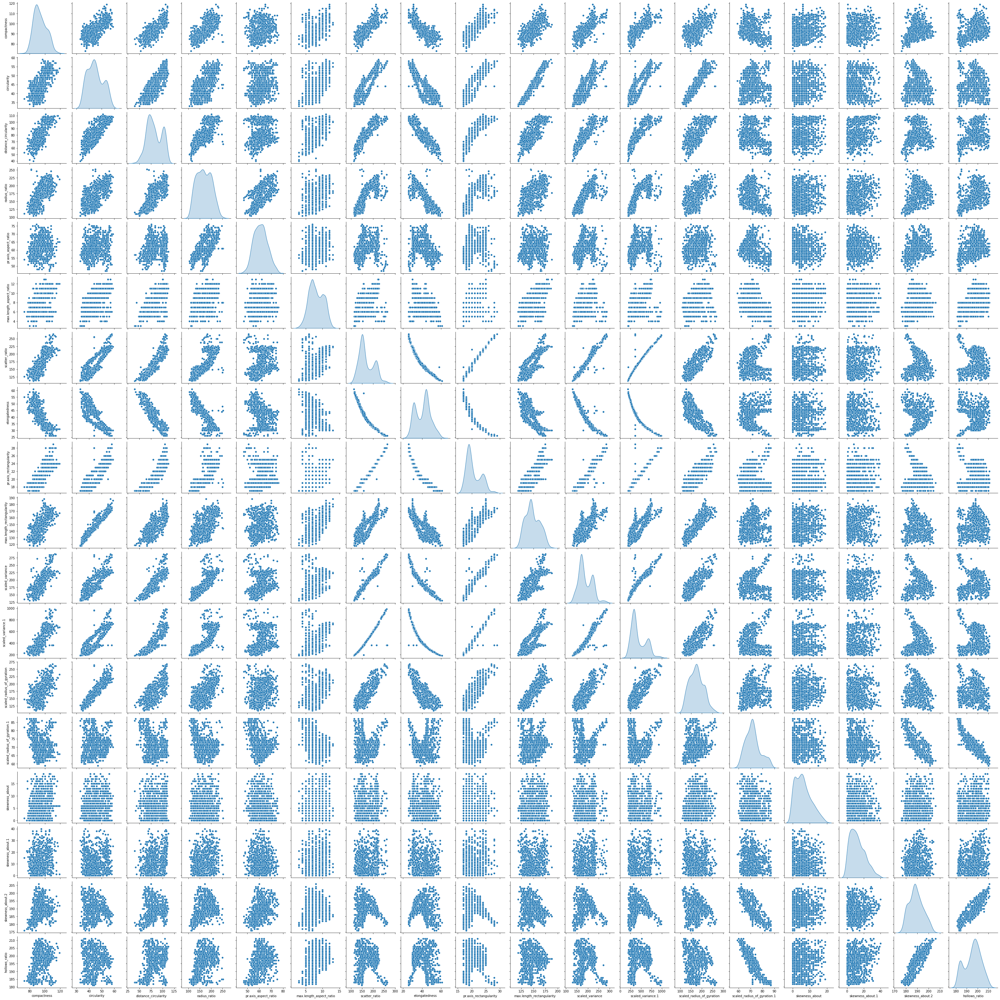

In [20]:
sns.pairplot(gm, diag_kind='kde')

<AxesSubplot:>

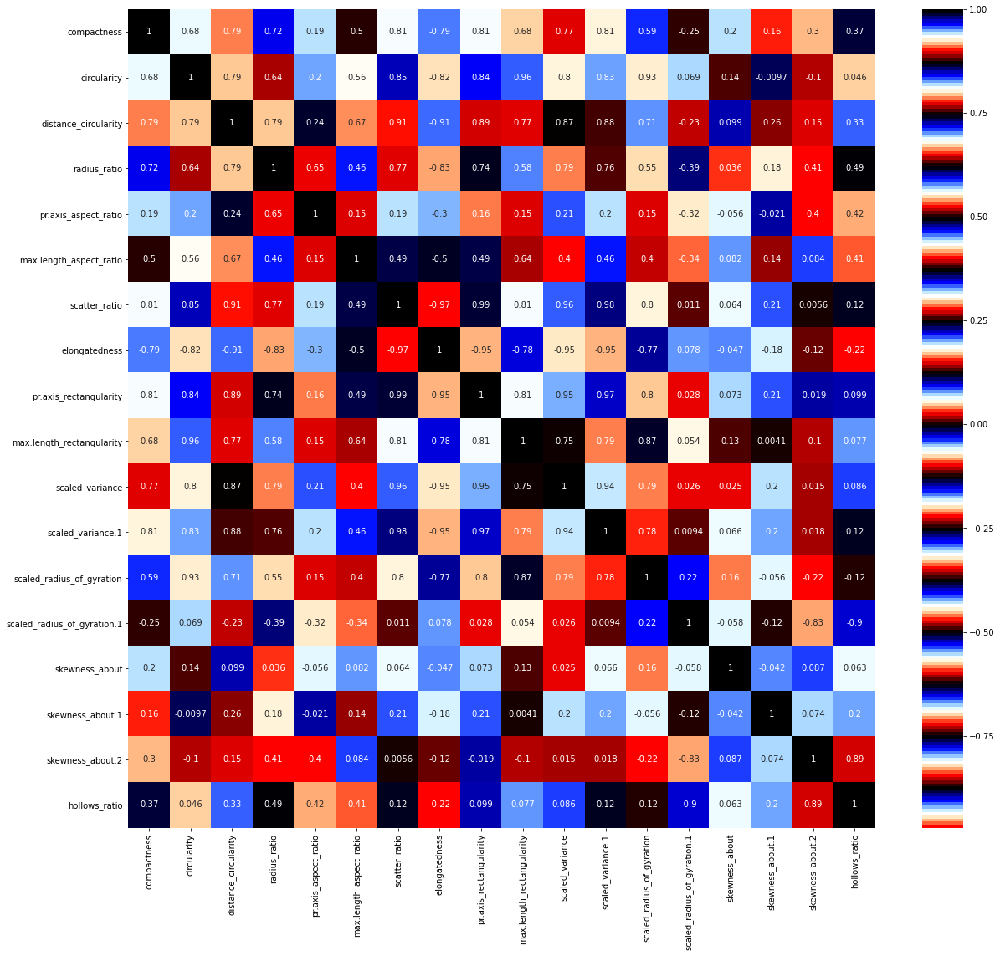

In [21]:
plt.figure(figsize=(20,18))

sns.heatmap(gm.corr(), annot=True, cmap="flag")

Dimensional reduction and Classifier

In [22]:
df = h2o.import_file("C:\\Users\\Admin\\Desktop\\UL_Project\\Part3 - vehicle.csv")

Parse progress: |████████████████████████████████████████████████████████████████| (done) 100%


In [23]:
import numpy as np
df.head()

compactness,circularity,distance_circularity,radius_ratio,pr.axis_aspect_ratio,max.length_aspect_ratio,scatter_ratio,elongatedness,pr.axis_rectangularity,max.length_rectangularity,scaled_variance,scaled_variance.1,scaled_radius_of_gyration,scaled_radius_of_gyration.1,skewness_about,skewness_about.1,skewness_about.2,hollows_ratio,class
95,48,83,178,72,10,162,42,20,159,176,379,184,70,6,16,187,197,van
91,41,84,141,57,9,149,45,19,143,170,330,158,72,9,14,189,199,van
104,50,106,209,66,10,207,32,23,158,223,635,220,73,14,9,188,196,car
93,41,82,159,63,9,144,46,19,143,160,309,127,63,6,10,199,207,van
85,44,70,205,103,52,149,45,19,144,241,325,188,127,9,11,180,183,bus
107,nan,106,172,50,6,255,26,28,169,280,957,264,85,5,9,181,183,bus
97,43,73,173,65,6,153,42,19,143,176,361,172,66,13,1,200,204,bus
90,43,66,157,65,9,137,48,18,146,162,281,164,67,3,3,193,202,van
86,34,62,140,61,7,122,54,17,127,141,223,112,64,2,14,200,208,van
93,44,98,nan,62,11,183,36,22,146,202,505,152,64,4,14,195,204,car


In [24]:
df.describe()

Rows:846
Cols:19




,compactness,circularity,distance_circularity,radius_ratio,pr.axis_aspect_ratio,max.length_aspect_ratio,scatter_ratio,elongatedness,pr.axis_rectangularity,max.length_rectangularity,scaled_variance,scaled_variance.1,scaled_radius_of_gyration,scaled_radius_of_gyration.1,skewness_about,skewness_about.1,skewness_about.2,hollows_ratio,class
type,int,int,int,int,int,int,int,int,int,int,int,int,int,int,int,int,int,int,enum
mins,73.0,33.0,40.0,104.0,47.0,2.0,112.0,26.0,17.0,118.0,130.0,184.0,109.0,59.0,0.0,0.0,176.0,181.0,
mean,93.67848699763604,44.82877526753867,82.1104513064132,168.88809523809502,61.67890995260661,8.56737588652483,168.9017751479289,40.93372781065084,20.582443653618018,147.99881796690298,188.63107947805455,439.4940758293837,174.70971563981058,72.44774346793342,6.364285714285713,12.602366863905331,188.91952662721883,195.63238770685578,
maxs,119.0,59.0,112.0,333.0,138.0,55.0,265.0,61.0,29.0,188.0,320.0,1018.0,268.0,135.0,22.0,41.0,206.0,211.0,
sigma,8.234474253334252,6.152171861813706,15.778291805673964,33.52019797334269,7.891463065900405,4.601216661132584,33.21484792133684,7.816185718829101,2.5929330612155854,14.515651573835008,31.411003596400807,176.66690269589344,32.584808232647724,7.486190275604501,4.920649076276184,8.936081294039763,6.155809475363881,7.438797429122352,
zeros,0,0,0,0,0,0,0,0,0,0,0,0,0,0,77,30,0,0,
missing,0,5,4,6,2,0,1,1,3,0,3,2,2,4,6,1,1,0,0
0,95.0,48.0,83.0,178.0,72.0,10.0,162.0,42.0,20.0,159.0,176.0,379.0,184.0,70.0,6.0,16.0,187.0,197.0,van
1,91.0,41.0,84.0,141.0,57.0,9.0,149.0,45.0,19.0,143.0,170.0,330.0,158.0,72.0,9.0,14.0,189.0,199.0,van
2,104.0,50.0,106.0,209.0,66.0,10.0,207.0,32.0,23.0,158.0,223.0,635.0,220.0,73.0,14.0,9.0,188.0,196.0,car


In [25]:
df.columns

['compactness',
 'circularity',
 'distance_circularity',
 'radius_ratio',
 'pr.axis_aspect_ratio',
 'max.length_aspect_ratio',
 'scatter_ratio',
 'elongatedness',
 'pr.axis_rectangularity',
 'max.length_rectangularity',
 'scaled_variance',
 'scaled_variance.1',
 'scaled_radius_of_gyration',
 'scaled_radius_of_gyration.1',
 'skewness_about',
 'skewness_about.1',
 'skewness_about.2',
 'hollows_ratio',
 'class']

In [26]:
df.isna()

isNA(compactness),isNA(circularity),isNA(distance_circularity),isNA(radius_ratio),isNA(pr.axis_aspect_ratio),isNA(max.length_aspect_ratio),isNA(scatter_ratio),isNA(elongatedness),isNA(pr.axis_rectangularity),isNA(max.length_rectangularity),isNA(scaled_variance),isNA(scaled_variance.1),isNA(scaled_radius_of_gyration),isNA(scaled_radius_of_gyration.1),isNA(skewness_about),isNA(skewness_about.1),isNA(skewness_about.2),isNA(hollows_ratio),isNA(class)
0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0
0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0
0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0
0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0
0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0
0,1,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0
0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0
0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0
0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0
0,0,0,1,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0


In [27]:
df[ df["circularity"].isna(), "circularity"] = 0
df[ df["distance_circularity"].isna(), "distance_circularity"] = 0
df[ df["radius_ratio"].isna(), "radius_ratio"] = 0
df[ df["pr.axis_aspect_ratio"].isna(), "pr.axis_aspect_ratio"] = 0
df[ df["scatter_ratio"].isna(), "scatter_ratio"] = 0
df[ df["elongatedness"].isna(), "elongatedness"] = 0
df[ df["pr.axis_rectangularity"].isna(), "pr.axis_rectangularity"] = 0
df[ df["scaled_variance"].isna(), "scaled_variance"] = 0
df[ df["scaled_variance.1"].isna(), "scaled_variance.1"] = 0
df[ df["scaled_radius_of_gyration"].isna(), "scaled_radius_of_gyration"] = 0
df[ df["scaled_radius_of_gyration.1"].isna(), "scaled_radius_of_gyration.1"] = 0
df[ df["skewness_about"].isna(), "skewness_about"] = 0
df[ df["skewness_about.1"].isna(), "skewness_about.1"] = 0
df[ df["skewness_about.2"].isna(), "skewness_about.2"] = 0

In [28]:
df.isna()

isNA(compactness),isNA(circularity),isNA(distance_circularity),isNA(radius_ratio),isNA(pr.axis_aspect_ratio),isNA(max.length_aspect_ratio),isNA(scatter_ratio),isNA(elongatedness),isNA(pr.axis_rectangularity),isNA(max.length_rectangularity),isNA(scaled_variance),isNA(scaled_variance.1),isNA(scaled_radius_of_gyration),isNA(scaled_radius_of_gyration.1),isNA(skewness_about),isNA(skewness_about.1),isNA(skewness_about.2),isNA(hollows_ratio),isNA(class)
0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0
0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0
0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0
0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0
0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0
0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0
0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0
0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0
0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0
0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0


In [29]:
train, valid = df.split_frame(ratios = [.8], seed = 1234)
gm_pca = H2OPrincipalComponentAnalysisEstimator(k = 6,
                                                   use_all_factor_levels = True,
                                                   pca_method = "glrm",
                                                   transform = "standardize",
                                                   impute_missing = True)
gm_pca.train(training_frame = train)

pca Model Build progress: |██████████████████████████████████████████████████████| (done) 100%
Model Details
H2OPrincipalComponentAnalysisEstimator :  Principal Components Analysis
Model Key:  PCA_model_python_1637400833869_8


Importance of components: 


,,pc1,pc2,pc3,pc4,pc5,pc6
0,Standard deviation,3.301050,2.141384,1.387178,0.800529,0.760328,0.613035
1,Proportion of Variance,0.573478,0.241325,0.101269,0.033726,0.030424,0.019778
2,Cumulative Proportion,0.573478,0.814803,0.916072,0.949798,0.980222,1.000000




ModelMetricsPCA: pca
** Reported on train data. **

MSE: NaN
RMSE: NaN

Scoring history from GLRM: 


,,timestamp,duration,iterations,step_size,objective
0,,2021-11-20 15:37:02,0.293 sec,0.0,0.666667,23864.710001
1,,2021-11-20 15:37:02,0.326 sec,1.0,0.444444,23864.710001
2,,2021-11-20 15:37:02,0.332 sec,2.0,0.222222,23864.710001
3,,2021-11-20 15:37:02,0.363 sec,3.0,0.074074,23864.710001
4,,2021-11-20 15:37:02,0.379 sec,4.0,0.077778,13230.498666
5,,2021-11-20 15:37:02,0.379 sec,5.0,0.081667,6517.755051
6,,2021-11-20 15:37:02,0.395 sec,6.0,0.085750,5434.790193
7,,2021-11-20 15:37:02,0.395 sec,7.0,0.090038,5013.298733
8,,2021-11-20 15:37:02,0.410 sec,8.0,0.094539,4621.712235
9,,2021-11-20 15:37:02,0.410 sec,9.0,0.099266,4332.412708



See the whole table with table.as_data_frame()


In [30]:
pred = gm_pca.predict(valid)
pred.head()

pca prediction progress: |███████████████████████████████████████████████████████| (done) 100%


PC1,PC2,PC3,PC4,PC5,PC6
0.261711,-1.69288,-0.591581,2.3436,-0.480915,0.514556
-0.738633,0.0100112,-0.18286,1.11567,1.32458,-0.155437
0.596814,1.01228,1.02359,0.41501,-0.605221,1.50541
0.595886,0.79644,0.197733,1.47802,-0.739702,0.464038
-1.02738,2.12535,3.36802,-0.898483,0.660193,0.0493423
-1.05419,1.94706,2.63529,-1.13959,4.75732,0.728513
1.01103,0.146326,-1.2997,-0.428888,-0.0477065,0.211118
0.961258,-2.68362,-3.73144,-1.25351,0.552719,-0.571587
-0.0154917,-1.64509,-4.06778,-1.20246,0.624953,-0.791027
-0.30561,-0.922264,-2.80582,-1.04617,0.832248,-1.80275


In [31]:
h2o.download_csv(pred,"C:\\Users\\Admin\\Desktop\\UL_Project")

'C:\\Users\\Admin\\Desktop\\UL_Project\\unknown'

In [32]:
pca_df = pd.read_csv('unknown.csv')
print(pca_df.shape)
pca_df.head()

(169, 6)


,PC1,PC2,PC3,PC4,PC5,PC6
0,-0.550515,-1.455035,-0.620586,0.904911,2.329491,0.432266
1,0.672855,-0.140634,0.251183,1.682191,0.280005,0.229848
2,-0.537566,1.134284,0.883038,-0.495166,0.850183,1.224060
3,-0.541855,0.863570,0.322688,0.231745,1.611843,-0.171900
4,0.878768,1.551943,3.517661,-0.669590,-1.139809,0.425993


In [33]:
pca_df.columns

Index(['PC1', 'PC2', 'PC3', 'PC4', 'PC5', 'PC6'], dtype='object')

In [34]:
pca_df.dtypes

PC1    float64
PC2    float64
PC3    float64
PC4    float64
PC5    float64
PC6    float64
dtype: object

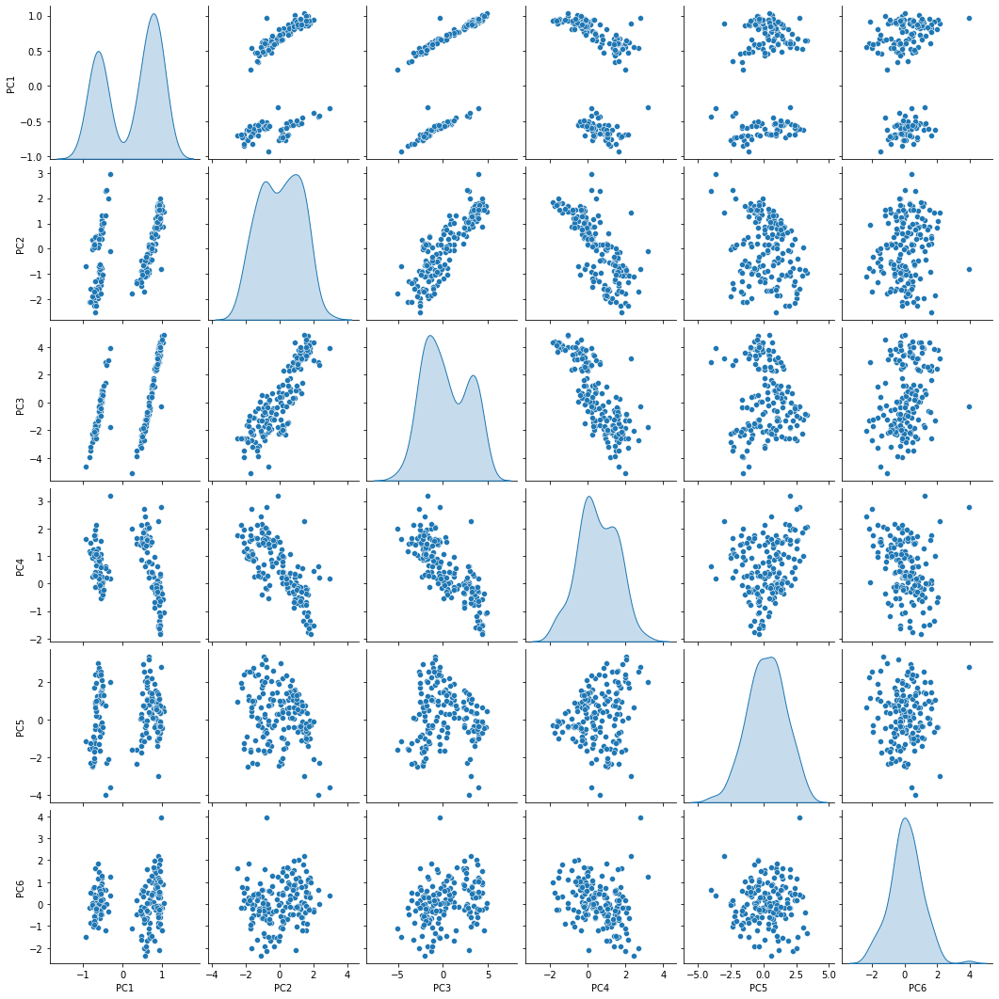

In [35]:
sns.pairplot(pca_df, diag_kind = 'kde');

In [36]:
pred.summary()

,PC1,PC2,PC3,PC4,PC5,PC6
type,real,real,real,real,real,real
mins,-1.49035277978515,-3.0920713463503735,-5.399418124579308,-2.7054723652368233,-1.3717406947379076,-2.3102232737872446
mean,-0.2663136922419451,0.09617222091974326,0.16161760853023388,0.4684380039753266,0.23011668527354476,-0.0668079797009858
maxs,1.468860362329572,3.4518629579161084,4.550456780703172,3.837174103143492,4.757315575856198,2.5453756212079823
sigma,0.7875834015148941,1.5380830712699036,2.4292523425515915,1.3376988152353748,0.8068389016891415,0.8601966684630572
zeros,0,0,0,0,0,0
missing,0,0,0,0,0,0
0,0.261711319263233,-1.6928822142736484,-0.5915806113495691,2.3436005984809665,-0.48091475538188555,0.5145560658086726
1,-0.7386334263842358,0.010011161913011914,-0.1828598135587042,1.1156737708088627,1.324575798913365,-0.15543722552337652
2,0.5968141393892453,1.0122840864021327,1.0235887103548709,0.41500977220319457,-0.6052210106464788,1.5054096811611142


In [37]:
PCA = pd.concat([gm.reset_index(drop=True), pca_df.reset_index(drop=True)], axis=1)
PCA.head()

,compactness,circularity,distance_circularity,radius_ratio,pr.axis_aspect_ratio,max.length_aspect_ratio,scatter_ratio,elongatedness,pr.axis_rectangularity,max.length_rectangularity,...,skewness_about.1,skewness_about.2,hollows_ratio,class,PC1,PC2,PC3,PC4,PC5,PC6
0,95,48.0,83.0,178.0,72.0,10,162.0,42.0,20.0,159,...,16.0,187.0,197,van,-0.550515,-1.455035,-0.620586,0.904911,2.329491,0.432266
1,91,41.0,84.0,141.0,57.0,9,149.0,45.0,19.0,143,...,14.0,189.0,199,van,0.672855,-0.140634,0.251183,1.682191,0.280005,0.229848
2,104,50.0,106.0,209.0,66.0,10,207.0,32.0,23.0,158,...,9.0,188.0,196,car,-0.537566,1.134284,0.883038,-0.495166,0.850183,1.224060
3,93,41.0,82.0,159.0,63.0,9,144.0,46.0,19.0,143,...,10.0,199.0,207,van,-0.541855,0.863570,0.322688,0.231745,1.611843,-0.171900
4,85,44.0,70.0,205.0,61.0,8,149.0,45.0,19.0,144,...,11.0,180.0,183,bus,0.878768,1.551943,3.517661,-0.669590,-1.139809,0.425993


In [38]:
for cols in PCA.columns:
    if(cols != 'class'): 
        PCA[cols] = PCA[cols].fillna(PCA[cols].median())

In [39]:
print(PCA.isnull().sum())

compactness                    0
circularity                    0
distance_circularity           0
radius_ratio                   0
pr.axis_aspect_ratio           0
max.length_aspect_ratio        0
scatter_ratio                  0
elongatedness                  0
pr.axis_rectangularity         0
max.length_rectangularity      0
scaled_variance                0
scaled_variance.1              0
scaled_radius_of_gyration      0
scaled_radius_of_gyration.1    0
skewness_about                 0
skewness_about.1               0
skewness_about.2               0
hollows_ratio                  0
class                          0
PC1                            0
PC2                            0
PC3                            0
PC4                            0
PC5                            0
PC6                            0
dtype: int64



          
██╗░░░░░██╗░░░██╗░█████╗░██╗███████╗███████╗██████╗░░░░░░░███╗░░░███╗██╗░░░░░
██║░░░░░██║░░░██║██╔══██╗██║██╔════╝██╔════╝██╔══██╗░░░░░░████╗░████║██║░░░░░
██║░░░░░██║░░░██║██║░░╚═╝██║█████╗░░█████╗░░██████╔╝█████╗██╔████╔██║██║░░░░░
██║░░░░░██║░░░██║██║░░██╗██║██╔══╝░░██╔══╝░░██╔══██╗╚════╝██║╚██╔╝██║██║░░░░░
███████╗╚██████╔╝╚█████╔╝██║██║░░░░░███████╗██║░░██║░░░░░░██║░╚═╝░██║███████╗
╚══════╝░╚═════╝░░╚════╝░╚═╝╚═╝░░░░░╚══════╝╚═╝░░╚═╝░░░░░░╚═╝░░░░░╚═╝╚══════╝

Started LuciferML 

Checking if labels or features are categorical! [*]

Features are not categorical [ ✓ ]

Labels are Categorical [*] 

Encoding Labels 

Encoding Labels Done [ ✓ ]

Checking for Categorical Variables Done [ ✓ ]

Checking for Sparse Matrix [*]

Splitting Data into Train and Validation Sets [*]

Splitting Done [ ✓ ]

Scaling Training and Test Sets [*]

Scaling Done [ ✓ ]

Training Support Vector Machine on Training Set [*]

Model Training Done [ ✓ ]

Predicting Data [*]

Data Prediction Done [ ✓ ]

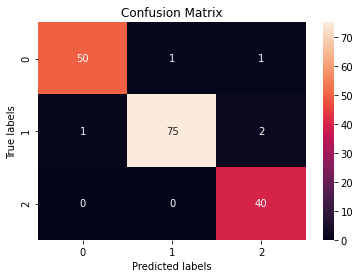

Confusion Matrix Done [ ✓ ]

Evaluating Model Performance [*]
Validation Accuracy is : 0.9705882352941176
Evaluating Model Performance [ ✓ ]

Applying K-Fold Cross Validation [*]
Accuracy: 95.26 %
Standard Deviation: 2.46 %
K-Fold Cross Validation [ ✓ ]

Complete [ ✓ ]

Time Elapsed :  0.7289822101593018 seconds 



In [40]:
from luciferml.supervised.classification import Classification
accuracy_scores =  {}
feature = ['compactness','circularity','distance_circularity','radius_ratio','pr.axis_aspect_ratio', 'max.length_aspect_ratio',
 'scatter_ratio','elongatedness','pr.axis_rectangularity', 'max.length_rectangularity','scaled_variance','scaled_variance.1',
 'scaled_radius_of_gyration','scaled_radius_of_gyration.1','skewness_about','skewness_about.1','skewness_about.2','hollows_ratio']
X = gm[feature]
y = gm['class']
classifier = Classification(predictor = 'svm')
classifier.fit(X, y)
result = classifier.result()


          
██╗░░░░░██╗░░░██╗░█████╗░██╗███████╗███████╗██████╗░░░░░░░███╗░░░███╗██╗░░░░░
██║░░░░░██║░░░██║██╔══██╗██║██╔════╝██╔════╝██╔══██╗░░░░░░████╗░████║██║░░░░░
██║░░░░░██║░░░██║██║░░╚═╝██║█████╗░░█████╗░░██████╔╝█████╗██╔████╔██║██║░░░░░
██║░░░░░██║░░░██║██║░░██╗██║██╔══╝░░██╔══╝░░██╔══██╗╚════╝██║╚██╔╝██║██║░░░░░
███████╗╚██████╔╝╚█████╔╝██║██║░░░░░███████╗██║░░██║░░░░░░██║░╚═╝░██║███████╗
╚══════╝░╚═════╝░░╚════╝░╚═╝╚═╝░░░░░╚══════╝╚═╝░░╚═╝░░░░░░╚═╝░░░░░╚═╝╚══════╝

Started LuciferML 

Checking if labels or features are categorical! [*]

Features are not categorical [ ✓ ]

Labels are Categorical [*] 

Encoding Labels 

Encoding Labels Done [ ✓ ]

Checking for Categorical Variables Done [ ✓ ]

Checking for Sparse Matrix [*]

Splitting Data into Train and Validation Sets [*]

Splitting Done [ ✓ ]

Scaling Training and Test Sets [*]

Scaling Done [ ✓ ]

Training Support Vector Machine on Training Set [*]

Model Training Done [ ✓ ]

Predicting Data [*]

Data Prediction Done [ ✓ ]

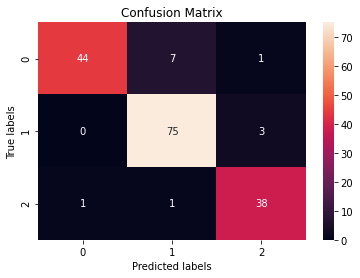

Confusion Matrix Done [ ✓ ]

Evaluating Model Performance [*]
Validation Accuracy is : 0.9235294117647059
Evaluating Model Performance [ ✓ ]

Applying K-Fold Cross Validation [*]
Accuracy: 90.97 %
Standard Deviation: 2.93 %
K-Fold Cross Validation [ ✓ ]

Complete [ ✓ ]

Time Elapsed :  0.4462108612060547 seconds 



In [41]:
feature = ['distance_circularity','radius_ratio','pr.axis_aspect_ratio', 'max.length_aspect_ratio',
 'scatter_ratio','pr.axis_rectangularity', 'max.length_rectangularity','scaled_variance.1','scaled_radius_of_gyration.1','skewness_about.1','skewness_about.2','hollows_ratio','PC2','PC3','PC5','PC6']
X = PCA[feature]
y = PCA['class']
classifier = Classification(predictor = 'svm')
classifier.fit(X,y)
result = classifier.result()

Both the models gave above 90% accuracy. The SVM accuracy with PCA data is slightly low despite of excluding huge chucks of data points.

# Part 4 - Sports Management

EDA and visualisation

In [42]:
ipl = pd.read_csv('Part4 - batting_bowling_ipl_bat.csv')
ipl2 = ipl.dropna()
print(ipl2.to_string())

                Name   Runs    Ave      SR  Fours  Sixes   HF
1           CH Gayle  733.0  61.08  160.74   46.0   59.0  9.0
3          G Gambhir  590.0  36.87  143.55   64.0   17.0  6.0
5           V Sehwag  495.0  33.00  161.23   57.0   19.0  5.0
7           CL White  479.0  43.54  149.68   41.0   20.0  5.0
9           S Dhawan  569.0  40.64  129.61   58.0   18.0  5.0
11         AM Rahane  560.0  40.00  129.33   73.0   10.0  5.0
13      KP Pietersen  305.0  61.00  147.34   22.0   20.0  3.0
15         RG Sharma  433.0  30.92  126.60   39.0   18.0  5.0
17    AB de Villiers  319.0  39.87  161.11   26.0   15.0  3.0
19         JP Duminy  244.0  81.33  128.42   13.0   11.0  2.0
21         DA Warner  256.0  36.57  164.10   28.0   14.0  3.0
23         SR Watson  255.0  42.50  151.78   26.0   14.0  2.0
25      F du Plessis  398.0  33.16  130.92   29.0   17.0  3.0
27           OA Shah  340.0  37.77  132.81   24.0   16.0  3.0
29          DJ Bravo  371.0  46.37  140.53   20.0   20.0  0.0
31      

In [43]:
ipl2.columns


Index(['Name', 'Runs', 'Ave', 'SR', 'Fours', 'Sixes', 'HF'], dtype='object')

In [44]:
ipl2.describe().T.style.bar(
    subset=['mean'],
    color='Reds').background_gradient(
    subset=['std'], cmap='ocean').background_gradient(subset=['50%'], cmap='PuBu')

,count,mean,std,min,25%,50%,75%,max
Runs,90.000000,219.933333,156.253669,2.000000,98.000000,196.500000,330.750000,733.000000
Ave,90.000000,24.729889,13.619215,0.500000,14.665000,24.440000,32.195000,81.330000
SR,90.000000,119.164111,23.656547,18.180000,108.745000,120.135000,131.997500,164.100000
Fours,90.000000,19.788889,16.399845,0.000000,6.250000,16.000000,28.000000,73.000000
Sixes,90.000000,7.577778,8.001373,0.000000,3.000000,6.000000,10.000000,59.000000
HF,90.000000,1.188889,1.688656,0.000000,0.000000,0.500000,2.000000,9.000000


In [45]:
def boxhistplot(columns,data):
    fig = px.histogram(ipl2, x = ipl2[column], color = 'Name')
    fig.show()
col = ['Runs']
for column in col:
    boxhistplot(column, ipl2)

In [46]:
def boxhistplot(columns,data):
    fig = px.histogram(ipl2, x = ipl2[column], color = 'Name')
    fig.show()
col = [ 'Ave']
for column in col:
    boxhistplot(column, ipl2)

In [47]:
def boxhistplot(columns,data):
    fig = px.histogram(ipl2, x = ipl2[column], color = 'Name')
    fig.show()
col = ['SR']
for column in col:
    boxhistplot(column, ipl2)

In [48]:
def boxhistplot(columns,data):
    fig = px.histogram(ipl2, x = ipl2[column], color = 'Name')
    fig.show()
col = ['Fours']
for column in col:
    boxhistplot(column, ipl2)

In [49]:
def boxhistplot(columns,data):
    fig = px.histogram(ipl2, x = ipl2[column], color = 'Name')
    fig.show()
col = ['Sixes']
for column in col:
    boxhistplot(column, ipl2)

In [50]:
def boxhistplot(columns,data):
    fig = px.histogram(ipl2, x = ipl2[column], color = 'Name')
    fig.show()
col = ['HF']
for column in col:
    boxhistplot(column, ipl2)

In [51]:
for col_name in ipl2.drop(columns = 'Name').columns:
    q1 = ipl2[col_name].quantile(0.25)
    q3 = ipl2[col_name].quantile(0.75)
    iqr = q3 - q1
    
    low = q1 - 1.5 * iqr
    high = q3 + 1.5 * iqr
    
    ipl2.loc[(ipl2[col_name] < low) | (ipl2[col_name] > high), col_name] = ipl2[col_name].median()

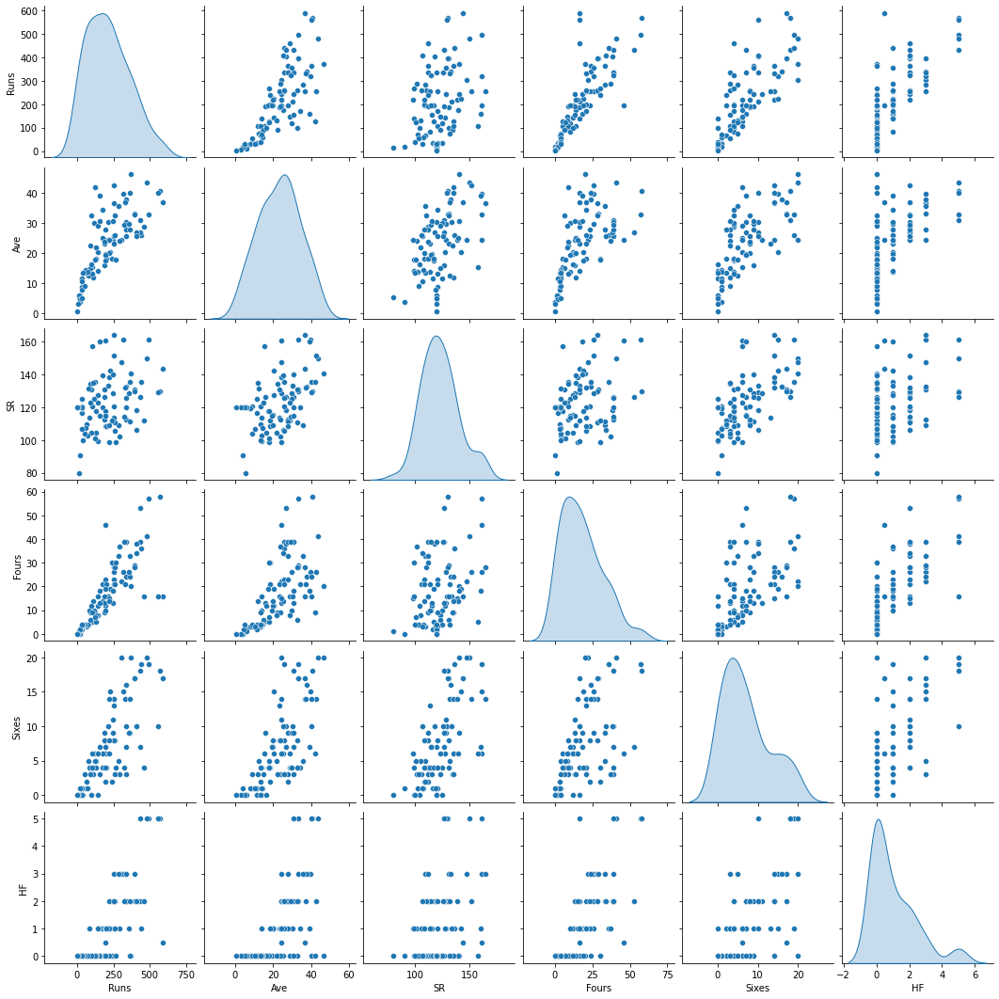

In [52]:
sns.pairplot(ipl2, diag_kind='kde')

<AxesSubplot:>

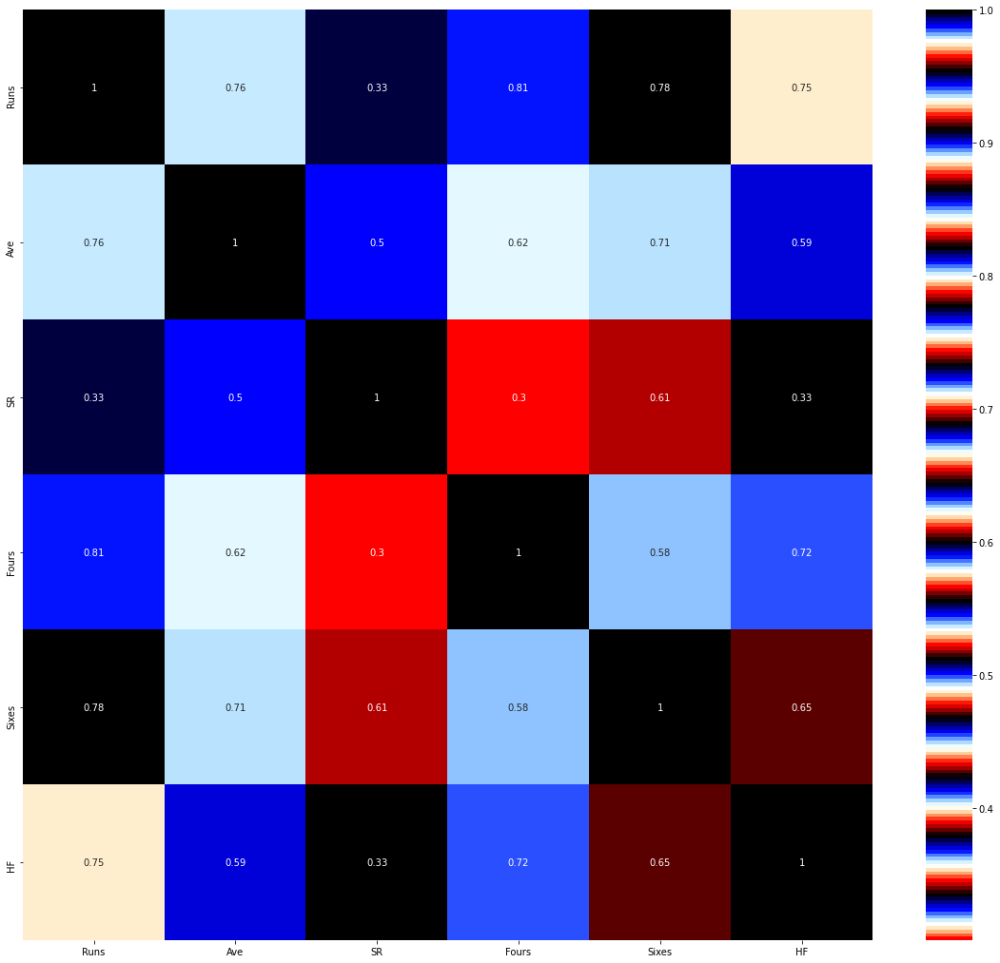

In [53]:
plt.figure(figsize=(20,18))

sns.heatmap(ipl2.corr(), annot=True, cmap="flag")

Data Driven Model

In [54]:
ipl3 = ipl2.iloc[:,1:7] 

In [55]:
ipl3.describe()

,Runs,Ave,SR,Fours,Sixes,HF
count,90.000000,90.000000,90.000000,90.000000,90.000000,90.000000
mean,213.972222,23.284444,122.861056,18.100000,6.988889,1.033333
std,146.382107,10.851282,16.832871,13.849147,5.829978,1.375549
min,2.000000,0.500000,80.000000,0.000000,0.000000,0.000000
25%,98.000000,14.665000,111.670000,6.250000,3.000000,0.000000
50%,196.250000,24.440000,120.202500,16.000000,6.000000,0.250000
75%,322.750000,30.585000,131.997500,26.000000,10.000000,2.000000
max,590.000000,46.370000,164.100000,58.000000,20.000000,5.000000


In [57]:
import h2o
from h2o.estimators import H2OKMeansEstimator
h2o.init(strict_version_check=False, url="http://192.168.59.147:54321")

Checking whether there is an H2O instance running at http://192.168.59.147:54321 ..... not found.
Attempting to start a local H2O server...
; Java HotSpot(TM) 64-Bit Server VM (build 25.311-b11, mixed mode)
  Starting server from C:\Users\Admin\anaconda3\Lib\site-packages\h2o\backend\bin\h2o.jar
  Ice root: C:\Users\Admin\AppData\Local\Temp\tmp8sra_7mr
  JVM stdout: C:\Users\Admin\AppData\Local\Temp\tmp8sra_7mr\h2o_Admin_started_from_python.out
  JVM stderr: C:\Users\Admin\AppData\Local\Temp\tmp8sra_7mr\h2o_Admin_started_from_python.err
  Server is running at http://127.0.0.1:54323
Connecting to H2O server at http://127.0.0.1:54323 ... successful.


H2O_cluster_uptime:,04 secs
H2O_cluster_timezone:,Asia/Kolkata
H2O_data_parsing_timezone:,UTC
H2O_cluster_version:,3.34.0.3
H2O_cluster_version_age:,1 month and 13 days
H2O_cluster_name:,H2O_from_python_Admin_7zm4v6
H2O_cluster_total_nodes:,1
H2O_cluster_free_memory:,1.689 Gb
H2O_cluster_total_cores:,8
H2O_cluster_allowed_cores:,8
H2O_cluster_status:,"locked, healthy"


In [58]:
from timeit import default_timer as timer
from datetime import timedelta
import time
start = timer()
end = timer()
print("Time:", timedelta(seconds=end-start))

Time: 0:00:00.000055


In [59]:
dataset_h2o = h2o.H2OFrame(ipl2)
h2o_km = H2OKMeansEstimator(k=2, init="furthest", standardize=True)
start = timer()
h2o_km.train(training_frame=dataset_h2o)
end = timer()
user_points = h2o.H2OFrame(h2o_km.centers())
h2o_km.show()
time_km = timedelta(seconds=end-start)
print("Time:", time_km)

Parse progress: |████████████████████████████████████████████████████████████████| (done) 100%
kmeans Model Build progress: |███████████████████████████████████████████████████| (done) 100%
Parse progress: |████████████████████████████████████████████████████████████████| (done) 100%
Model Details
H2OKMeansEstimator :  K-means
Model Key:  KMeans_model_python_1637403440366_1


Model Summary: 


,,number_of_rows,number_of_clusters,number_of_categorical_columns,number_of_iterations,within_cluster_sum_of_squares,total_sum_of_squares,between_cluster_sum_of_squares
0,,90.0,2.0,0.0,3.0,274.791997,534.0,259.208003




ModelMetricsClustering: kmeans
** Reported on train data. **

MSE: NaN
RMSE: NaN
Total Within Cluster Sum of Square Error: 274.79199757458264
Total Sum of Square Error to Grand Mean: 533.999999018899
Between Cluster Sum of Square Error: 259.2080014443163

Centroid Statistics: 


,,centroid,size,within_cluster_sum_of_squares
0,,1.0,38.0,161.022319
1,,2.0,52.0,113.769679



Scoring History: 


,,timestamp,duration,iterations,number_of_reassigned_observations,within_cluster_sum_of_squares
0,,2021-11-20 15:47:42,0.056 sec,0.0,NaN,NaN
1,,2021-11-20 15:47:42,0.149 sec,1.0,90.0,527.943181
2,,2021-11-20 15:47:42,0.181 sec,2.0,1.0,275.111288
3,,2021-11-20 15:47:42,0.181 sec,3.0,0.0,274.791997


Time: 0:00:00.443291


In [60]:
data_h2o_dataset = h2o.H2OFrame(ipl2)
h2o_km_dataset = H2OKMeansEstimator(k=2, init="furthest", standardize=True)
start = timer()
h2o_km_dataset.train(x=["Runs", "Ave", "SR", "Fours", "Sixes", "HF"], training_frame=data_h2o_dataset)
end = timer()
user_points = h2o.H2OFrame(h2o_km_dataset.centers())
h2o_km_dataset.show()
print("Time:", timedelta(seconds=end-start))

Parse progress: |████████████████████████████████████████████████████████████████| (done) 100%
kmeans Model Build progress: |███████████████████████████████████████████████████| (done) 100%
Parse progress: |████████████████████████████████████████████████████████████████| (done) 100%
Model Details
H2OKMeansEstimator :  K-means
Model Key:  KMeans_model_python_1637403440366_2


Model Summary: 


,,number_of_rows,number_of_clusters,number_of_categorical_columns,number_of_iterations,within_cluster_sum_of_squares,total_sum_of_squares,between_cluster_sum_of_squares
0,,90.0,2.0,0.0,5.0,274.791997,534.0,259.208003




ModelMetricsClustering: kmeans
** Reported on train data. **

MSE: NaN
RMSE: NaN
Total Within Cluster Sum of Square Error: 274.79199757458264
Total Sum of Square Error to Grand Mean: 533.999999018899
Between Cluster Sum of Square Error: 259.2080014443163

Centroid Statistics: 


,,centroid,size,within_cluster_sum_of_squares
0,,1.0,38.0,161.022319
1,,2.0,52.0,113.769679



Scoring History: 


,,timestamp,duration,iterations,number_of_reassigned_observations,within_cluster_sum_of_squares
0,,2021-11-20 15:48:01,0.005 sec,0.0,NaN,NaN
1,,2021-11-20 15:48:01,0.024 sec,1.0,90.0,638.714608
2,,2021-11-20 15:48:01,0.026 sec,2.0,8.0,297.874877
3,,2021-11-20 15:48:01,0.027 sec,3.0,5.0,280.975640
4,,2021-11-20 15:48:01,0.028 sec,4.0,2.0,275.437811
5,,2021-11-20 15:48:01,0.029 sec,5.0,0.0,274.791997


Time: 0:00:00.273586


In [61]:
from h2o.estimators.aggregator import H2OAggregatorEstimator

params = { "target_num_exemplars": 200,
    "rel_tol_num_exemplars": 0.5,
    "categorical_encoding": "eigen"}

agg = H2OAggregatorEstimator(**params)

start = timer()
agg.train(x=["Name","Runs", "Ave", "SR", "Fours", "Sixes", "HF"], training_frame=data_h2o_dataset)
data_agg_12_dataset = agg.aggregated_frame
h2o_km_co_agg_12_dataset = H2OKMeansEstimator(k=2, user_points=user_points, standardize=True)

h2o_km_co_agg_12_dataset.train(x=["Name","Runs", "Ave", "SR", "Fours", "Sixes", "HF"],training_frame=data_agg_12_dataset)
end = timer()
h2o_km_co_agg_12_dataset.show()
time_h2o_km_co_agg_12_dataset = timedelta(seconds=end-start)
print("Time:", time_h2o_km_co_agg_12_dataset)

aggregator Model Build progress: |███████████████████████████████████████████████| (done) 100%
kmeans Model Build progress: |███████████████████████████████████████████████████| (done) 100%
Model Details
H2OKMeansEstimator :  K-means
Model Key:  KMeans_model_python_1637403440366_4


Model Summary: 


,,number_of_rows,number_of_clusters,number_of_categorical_columns,number_of_iterations,within_cluster_sum_of_squares,total_sum_of_squares,between_cluster_sum_of_squares
0,,90.0,2.0,0.0,2.0,274.791997,534.0,259.208003




ModelMetricsClustering: kmeans
** Reported on train data. **

MSE: NaN
RMSE: NaN
Total Within Cluster Sum of Square Error: 274.79199757458264
Total Sum of Square Error to Grand Mean: 533.999999018899
Between Cluster Sum of Square Error: 259.2080014443163

Centroid Statistics: 


,,centroid,size,within_cluster_sum_of_squares
0,,1.0,38.0,161.022319
1,,2.0,52.0,113.769679



Scoring History: 


,,timestamp,duration,iterations,number_of_reassigned_observations,within_cluster_sum_of_squares
0,,2021-11-20 15:48:18,0.000 sec,0.0,NaN,NaN
1,,2021-11-20 15:48:18,0.000 sec,1.0,90.0,274.791997
2,,2021-11-20 15:48:18,0.017 sec,2.0,0.0,274.791997


Time: 0:00:00.800094


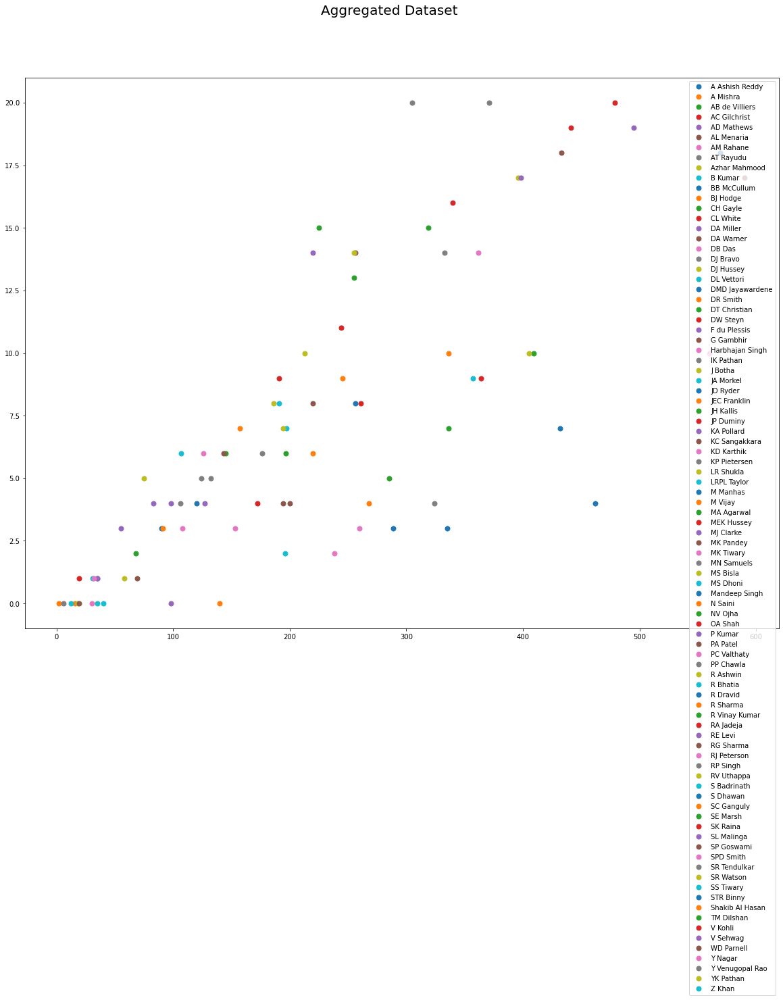

In [62]:
data_agg_df_12_dataset = data_agg_12_dataset.as_data_frame()
data_agg_df_12_dataset["Name"] = data_agg_df_12_dataset["Name"].astype("category")

groups = data_agg_df_12_dataset.groupby("Name")
fig, ax = plt.subplots(1,1,figsize=(20,15))
for name, group in groups:
    ax.plot(group.Runs, group.Sixes, marker='o', linestyle='', ms=7, label=name)

fig.suptitle("Aggregated Dataset", fontsize=20)  
ax.legend(numpoints=1)

In [63]:
data_agg_df_12_dataset.head()

,Name,Runs,Ave,SR,Fours,Sixes,HF,counts
0,CH Gayle,196.5,24.44,160.74,46,6,0.5,1
1,G Gambhir,590.0,36.87,143.55,16,17,0.5,1
2,V Sehwag,495.0,33.00,161.23,57,19,5.0,1
3,CL White,479.0,43.54,149.68,41,20,5.0,1
4,S Dhawan,569.0,40.64,129.61,58,18,5.0,1


In [64]:
b1= data_agg_df_12_dataset.groupby('Name')['Runs'].sum().sort_values(ascending = False ).head(10)
b2= data_agg_df_12_dataset.groupby('Name')['Ave'].sum().sort_values(ascending = False ).head(10)
b3= data_agg_df_12_dataset.groupby('Name')['SR'].sum().sort_values(ascending = False ).head(10)
b4= data_agg_df_12_dataset.groupby('Name')['Fours'].sum().sort_values(ascending = False ).head(10)
b5= data_agg_df_12_dataset.groupby('Name')['Sixes'].sum().sort_values(ascending = False ).head(10)
b6= data_agg_df_12_dataset.groupby('Name')['HF'].sum().sort_values(ascending = False ).head(10)
print(b1.to_string())
print(b2.to_string())
print(b3.to_string())
print(b4.to_string())
print(b5.to_string())
print(b6.to_string())
#Top 10 players by Runs, Average, Strike Rate, Fours, Sixes and Half Centuries

Name
G Gambhir        590.0
S Dhawan         569.0
AM Rahane        560.0
V Sehwag         495.0
CL White         479.0
R Dravid         462.0
SK Raina         441.0
RG Sharma        433.0
Mandeep Singh    432.0
JH Kallis        409.0
Name
DJ Bravo          46.37
CL White          43.54
SR Watson         42.50
DB Das            42.00
S Dhawan          40.64
SPD Smith         40.22
AM Rahane         40.00
AB de Villiers    39.87
DR Smith          39.25
OA Shah           37.77
Name
DA Warner         164.10
V Sehwag          161.23
AB de Villiers    161.11
CH Gayle          160.74
DR Smith          160.20
JA Morkel         157.35
SR Watson         151.78
CL White          149.68
KP Pietersen      147.34
G Gambhir         143.55
Name
S Dhawan           58
V Sehwag           57
Mandeep Singh      53
CH Gayle           46
CL White           41
M Vijay            39
SR Tendulkar       39
RG Sharma          39
DMD Jayawardene    39
SE Marsh           39
Name
DJ Bravo        20
CL White        

# Part 5 : Dimensionality reduction Techniques

Dimensionality reduction techniques that can be implemented using python
1 Missing Value Ratio
2 Low Variance Filter
3 High Correlation Filter
4 Random Forest
5 Backward Feature Elimination
6 Forward Feature Selection
7 Factor Analysis
8 Principal Component Analysis
9 Independent Component Analysis
10 Methods Based on Projections
11 t-Distributed Stochastic Neighbor Embedding (t-SNE)
12 UMAP
13 Autoencoder

Dimensional reduction on image data using simplest possible autoencoder

In [65]:
import keras
from keras import layers
encoding_dim = 32
input_img = keras.Input(shape=(784,))
encoded = layers.Dense(encoding_dim, activation='relu')(input_img)
decoded = layers.Dense(784, activation='sigmoid')(encoded)
autoencoder = keras.Model(input_img, decoded)

In [66]:
encoder = keras.Model(input_img, encoded)


In [67]:
encoded_input = keras.Input(shape=(encoding_dim,))
decoder_layer = autoencoder.layers[-1]
decoder = keras.Model(encoded_input, decoder_layer(encoded_input))

In [68]:
autoencoder.compile(optimizer='adam', loss='binary_crossentropy')

In [69]:
from keras.datasets import mnist
import numpy as np
(x_train, _), (x_test, _) = mnist.load_data()

In [70]:
x_train = x_train.astype('float32') / 255.
x_test = x_test.astype('float32') / 255.
x_train = x_train.reshape((len(x_train), np.prod(x_train.shape[1:])))
x_test = x_test.reshape((len(x_test), np.prod(x_test.shape[1:])))
print(x_train.shape)
print(x_test.shape)

(60000, 784)
(10000, 784)


In [71]:
autoencoder.fit(x_train, x_train,
                epochs=50,
                batch_size=256,
                shuffle=True,
                validation_data=(x_test, x_test))

Epoch 1/50
235/235 [==============================] - 15s 52ms/step - loss: 0.2764 - val_loss: 0.1876
Epoch 2/50
235/235 [==============================] - 11s 49ms/step - loss: 0.1702 - val_loss: 0.1542
Epoch 3/50
235/235 [==============================] - 11s 49ms/step - loss: 0.1451 - val_loss: 0.1348
Epoch 4/50
235/235 [==============================] - 11s 49ms/step - loss: 0.1294 - val_loss: 0.1219
Epoch 5/50
235/235 [==============================] - 12s 50ms/step - loss: 0.1185 - val_loss: 0.1130
Epoch 6/50
235/235 [==============================] - 11s 48ms/step - loss: 0.1110 - val_loss: 0.1070
Epoch 7/50
235/235 [==============================] - 11s 48ms/step - loss: 0.1058 - val_loss: 0.1026
Epoch 8/50
235/235 [==============================] - 13s 54ms/step - loss: 0.1022 - val_loss: 0.0995
Epoch 9/50
235/235 [==============================] - 11s 47ms/step - loss: 0.0995 - val_loss: 0.0972
Epoch 10/50
235/235 [==============================] - 11s 47ms/step - loss: 0.097

In [72]:
encoded_imgs = encoder.predict(x_test)
decoded_imgs = decoder.predict(encoded_imgs)

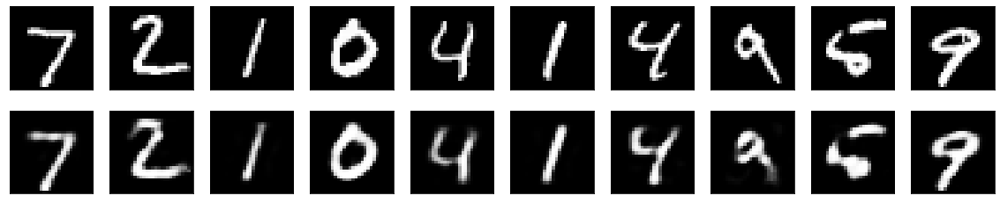

In [73]:
import matplotlib.pyplot as plt

n = 10 
plt.figure(figsize=(20, 4))
for i in range(n):
    ax = plt.subplot(2, n, i + 1)
    plt.imshow(x_test[i].reshape(28, 28))
    plt.gray()
    ax.get_xaxis().set_visible(False)
    ax.get_yaxis().set_visible(False)

    ax = plt.subplot(2, n, i + 1 + n)
    plt.imshow(decoded_imgs[i].reshape(28, 28))
    plt.gray()
    ax.get_xaxis().set_visible(False)
    ax.get_yaxis().set_visible(False)
plt.show()